# Training DetecTreeRGB

In this notebook we train a Mask R-CNN model using our tiled tiff and shapefile of manually delineated tree crowns.

First, let's install/import detectron2 and check it all works ok!

REMEMBER TO EDIT SETTINGS TO INCLUDE GPU

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [ ]:
### install dependencies:

# might need to install opencv
#!pip3 install Cython cupy-cuda112 cupy-cuda102   # Probably only need one of these but it works so I'm gonna leave it for now.
!pip -q install pyyaml==5.1

# Torch 1.8.1 does not work despite being the latest stable release. As such, use 1.7. 
# Cuda version on MAGEOHub is currently 11.3 - cu110 all works fine.

# To be tried once the bug with torch 1.8 has been fixed 
# !pip3 install torch==1.8.1+cu111 torchvision==0.9.1+cu111 torchaudio==0.8.1 -f https://download.pytorch.org/whl/torch_stable.html

# !pip install torch==1.7.1+cu110 torchvision==0.8.2+cu110 torchaudio==0.7.2 -f https://download.pytorch.org/whl/torch_stable.html
# !python -m pip install detectron2 -f https://dl.fbaipublicfiles.com/detectron2/wheels/cu110/torch1.7/index.html

### colab has updated it's pytorch version...need new Detectron2 version
!pip install detectron2==0.6 -f \
  https://dl.fbaipublicfiles.com/detectron2/wheels/cu113/torch1.10/index.html
# exit(0)  # After installation, you need to "restart runtime" in Colab. This line can also restart runtime

     |████████████████████████████████| 274 kB 5.3 MB/s 
Looking in links: https://dl.fbaipublicfiles.com/detectron2/wheels/cu113/torch1.10/index.html
     |████████████████████████████████| 7.0 MB 855 kB/s 
     |████████████████████████████████| 74 kB 2.6 MB/s 
     |████████████████████████████████| 147 kB 10.7 MB/s 
     |████████████████████████████████| 50 kB 7.5 MB/s 
     |████████████████████████████████| 130 kB 64.1 MB/s 
     |████████████████████████████████| 843 kB 69.1 MB/s 
     |████████████████████████████████| 749 kB 62.1 MB/s 
     |████████████████████████████████| 112 kB 77.1 MB/s 
  Created wheel for fvcore: filename=fvcore-0.1.5.post20220414-py3-none-any.whl size=61211 sha256=9d60ade23c7b70b8f67595c0b804a4683ac814353af0134358cc8786420e7811
  Stored in directory: /root/.cache/pip/wheels/df/f4/b8/7b5df8b6722f4c72315ce70c31aa693e00cef6a5056149bd28
  Created wheel for antlr4-python3-runtime: filename=antlr4_python3_runtime-4.8-py3-none-any.whl size=141230 sha256=b9cb

In [ ]:
# Import torch and check versions and cuda availability, and resources
import torch, torchvision
print(torch.__version__, torch.cuda.is_available())
!gcc --version
!nvcc --version
!nvidia-smi

from IPython.display import display, clear_output

1.10.0+cu111 True
gcc (Ubuntu 7.5.0-3ubuntu1~18.04) 7.5.0
Copyright (C) 2017 Free Software Foundation, Inc.
This is free software; see the source for copying conditions.  There is NO
warranty; not even for MERCHANTABILITY or FITNESS FOR A PARTICULAR PURPOSE.

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2020 NVIDIA Corporation
Built on Mon_Oct_12_20:09:46_PDT_2020
Cuda compilation tools, release 11.1, V11.1.105
Build cuda_11.1.TC455_06.29190527_0
Thu Apr 21 14:03:18 2022       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 460.32.03    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|========================

In [ ]:
# Some basic imports:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# tensorboard?
#%load_ext tensorboard
#%tensorboard --logdir output

# necessary libraries
import pandas as pd
import numpy as np
import cv2
import random
import matplotlib.pyplot as plt
from PIL import Image
import os
import numpy as np
import json
import glob

from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog
from detectron2.structures import BoxMode


# Testing on Online Image (can ignore)

In [ ]:
### The following two cells just determine that the setup is working correctly on a standard example.

# Get image, hash wget line if already downloaded.
# Just unhash if running this code for the first time, i.e. input.jpg has not yet been downloaded

!wget http://images.cocodataset.org/val2017/000000439715.jpg -O input.jpg
im = cv2.imread("./input.jpg")

# Create config
cfg = get_cfg()

cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_101_FPN_3x.yaml"))

#cfg.merge_file = 'https://github.com/facebookresearch/detectron2/blob/master/configs/COCO-InstanceSegmentation/mask_rcnn_R_101_FPN_3x.yaml'
#cfg.merge_from_file("./detectron2/configs/COCO-Detection/faster_rcnn_R_101_FPN_3x.yaml")

cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5  # set threshold for this model

# Bit worried this line won't work for everyone - if it doesn't, go to https://github.com/facebookresearch/detectron2/blob/master/MODEL_ZOO.md to find a link to the model weights

#cfg.MODEL.WEIGHTS = "detectron2://COCO-Detection/faster_rcnn_R_101_FPN_3x/137851257/model_final_f6e8b1.pkl"

# Here we just get the pre-trained weights straight from facebook hosting website

cfg.MODEL.WEIGHTS = 'https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_101_FPN_3x/138205316/model_final_a3ec72.pkl'



# Create predictor
predictor = DefaultPredictor(cfg)

# Make prediction
outputs = predictor(im)

--2022-04-19 14:10:53--  http://images.cocodataset.org/val2017/000000439715.jpg
Resolving images.cocodataset.org (images.cocodataset.org)... 52.217.138.145
Connecting to images.cocodataset.org (images.cocodataset.org)|52.217.138.145|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 209222 (204K) [image/jpeg]
Saving to: ‘input.jpg’

input.jpg           100%[===================>] 204.32K  1.07MB/s    in 0.2s    

2022-04-19 14:10:54 (1.07 MB/s) - ‘input.jpg’ saved [209222/209222]



model_final_a3ec72.pkl: 0.00B [00:00, ?B/s]
Failed to download https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_101_FPN_3x/138205316/model_final_a3ec72.pkl


URLError: ignored

In [ ]:
# Make sure the inevitable error messages are useful.
CUDA_LAUNCH_BLOCKING="1"

In [ ]:
# Let's have a look
v = Visualizer(im[:, :, ::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.2)
v = v.draw_instance_predictions(outputs["instances"].to("cpu"))

image = cv2.cvtColor(v.get_image()[:, :, ::-1], cv2.COLOR_BGR2RGB)
display(Image.fromarray(image))

# Code set up

In [ ]:
# Make sure the inevitable error messages are useful.
CUDA_LAUNCH_BLOCKING="1"

In [ ]:
### @James Ball
### Ok so, here, we are adding this imagePath line to every GeoJSON so it knows what PNG it is attached to!
### This should probably be in the tiling script...

import os
import json
#forest = "sepilok_west"
entries = os.listdir('gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_train')
print (entries)

['zone1.png', 'zone1.png.aux.xml', 'zone4.png', 'zone5.png', 'zone6.png', 'zone7.png', 'tile_684090_4743120.png', 'tile_684090_4743320.png', 'tile_684090_4743520.png', 'tile_684090_4743720.png', 'tile_684290_4743120.png', 'tile_684290_4743320.png', 'tile_684290_4743520.png', 'tile_684290_4743720.png', 'tile_684490_4743120.png', 'tile_684490_4743320.png', 'tile_684490_4743520.png', 'tile_684490_4743720.png', 'tile_684690_4743120.png', 'tile_684690_4743520.png', 'tile_684690_4743720.png', 'tile_684890_4743320.png', 'tile_684890_4743520.png', 'tile_684890_4743720.png', 'tile_684490_4743320.geojson', 'tile_684690_4743720.geojson', 'tile_684090_4743120.geojson', 'tile_684490_4743520.geojson', 'tile_684490_4743120.geojson', 'tile_684290_4743720.geojson', 'zone7.geojson', 'tile_684690_4743120.geojson', 'tile_684690_4743520.geojson', 'zone5.geojson', 'tile_684490_4743720.geojson', 'tile_684290_4743520.geojson', 'tile_684890_4743520.geojson', 'tile_684890_4743720.geojson', 'tile_684890_4743320.

In [ ]:
# NOTE this needs to be done on all files - even the ones in the training folder as otherwise
# imagePath cannot be found. Should make more general at some point but for now before you move
# the items across to a test folder run this script on all the pngs/ geojsons

for i in entries:
    if 'geojson' in i: 
        filename = 'gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_train/' + i
        #print(i)
        print(filename)
        j=i[:-8]
        #print(j)
        k= j+ '.png'
        Dict = {"imagePath":  k }
        #print(Dict)

        with open(filename,"r") as f:
           data = json.load(f)
           data.update(Dict)
        with open(filename,"w") as f:
            json.dump(data,f)

gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_train/tile_684490_4743320.geojson
gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_train/tile_684690_4743720.geojson
gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_train/tile_684090_4743120.geojson
gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_train/tile_684490_4743520.geojson
gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_train/tile_684490_4743120.geojson
gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_train/tile_684290_4743720.geojson
gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_train/zone7.geojson
gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_train/tile_684690_4743120.geojson
gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_train/tile_684690_4743520.geojson
gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_train/zone5.geojson
gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_train/tile_684490_4743720.geojson
gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_train/tile_684290_4743520.geojson
gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_train/tile_684890_4743520.geojson
g

In [ ]:
#### Nice bit of code to grab our manual delineations

def get_tree_dicts(directory):
    classes = ['tree']
    dataset_dicts = []
    for filename in [file for file in os.listdir(directory) if file.endswith('.geojson')]:
        json_file = os.path.join(directory, filename)
        with open(json_file) as f:
            img_anns = json.load(f)  
               
        #print(img_anns)
        record = {}
        
        filename = os.path.join(directory, img_anns["imagePath"])
        #print("filename", filename)
        # Make sure we have the correct height and width
        height, width = cv2.imread(filename).shape[:2]

        record["file_name"] = filename
        record["height"] = height
        record["width"] = width
        record["image_id"] = filename[0:400]
        print(filename[0:400])
            
        

        objs = []
        for features in img_anns['features']:
            # print(features)
            anno = features['geometry']
            # print("##### HERE IS AN ANNO #####", anno)#...weirdly sometimes (but not always) have to make 1000 into a np.array
            px = [a[0] for a in anno['coordinates'][0]]
            py = [np.array(height) - a[1] for a in anno['coordinates'][0]]
            #py = [a[1] for a in anno['coordinates'][0]]
            # print("### HERE IS PY ###", py)
            poly = [(x, y) for x, y in zip(px, py)]
            poly = [p for x in poly for p in x]
            # print("#### HERE ARE SOME POLYS #####", poly)
            obj = {
                   "bbox": [np.min(px), np.min(py), np.max(px), np.max(py)],
                   "bbox_mode": BoxMode.XYXY_ABS,
                   "segmentation": [poly],
                   "category_id": 0,
                   "iscrowd": 0
                   }
            objs.append(obj)
            # print("#### HERE IS OBJS #####", objs)
        record["annotations"] = objs
        dataset_dicts.append(record)
    return dataset_dicts

from detectron2.data import DatasetCatalog, MetadataCatalog

from detectron2.data import DatasetCatalog, MetadataCatalog
for d in ["train", "test"]:
    # DatasetCatalog.remove("trees_" + d)
    DatasetCatalog.register("trees_" + d, lambda d=d: get_tree_dicts('gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_' + d))
    MetadataCatalog.get("trees_" + d).set(thing_classes=['tree'])
    # MetadataCatalog.remove("trees_" + d)


trees_metadata = MetadataCatalog.get("trees_train")


gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_train/tile_684490_4743320.png
gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_train/tile_684690_4743720.png
gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_train/tile_684090_4743120.png
gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_train/tile_684490_4743520.png
gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_train/tile_684490_4743120.png
gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_train/tile_684290_4743720.png
gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_train/zone7.png
gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_train/tile_684690_4743120.png
gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_train/tile_684690_4743520.png
gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_train/zone5.png
gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_train/tile_684490_4743720.png
gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_train/tile_684290_4743520.png
gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_train/tile_684890_4743520.png
gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_train/ti

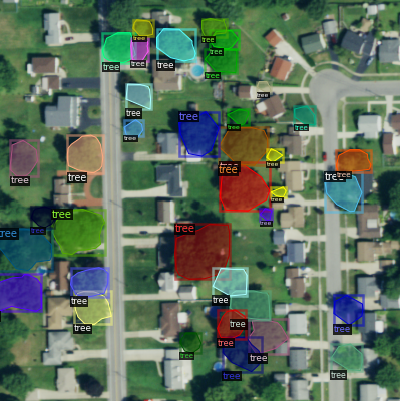

In [ ]:
# Let's look at our training image and annos for our geojson sepilok dataset!!!
import matplotlib.pyplot as plt

dataset_dicts = get_tree_dicts('gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_train')
print(dataset_dicts)
for d in random.sample(dataset_dicts, 1):
    #for d in dataset_dicts:
    print(d)
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=trees_metadata, scale=1)
    out = visualizer.draw_dataset_dict(d)
    image = cv2.cvtColor(out.get_image()[:, :, ::-1], cv2.COLOR_BGR2RGB)
    #display(Image.fromarray(img))
    #cv2_imshow(image)
    display(Image.fromarray(image))
    #plt.figure(figsize=(10,15))
    #plt.imshow(out.get_image())
    #plt.show()

# Training

In [ ]:
### Setup the evaluator

from detectron2.evaluation import (
    CityscapesInstanceEvaluator,
    CityscapesSemSegEvaluator,
    COCOEvaluator,
    COCOPanopticEvaluator,
    DatasetEvaluators,
    LVISEvaluator,
    PascalVOCDetectionEvaluator,
    SemSegEvaluator,
    verify_results,
)

from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader


In [ ]:
from detectron2.engine.hooks import HookBase
from detectron2.evaluation import inference_context
from detectron2.utils.logger import log_every_n_seconds
from detectron2.data import DatasetMapper, build_detection_test_loader, build_detection_train_loader
import detectron2.utils.comm as comm
#import torch
import time
import datetime

class LossEvalHook(HookBase):
    def __init__(self, eval_period, model, data_loader):
        self._model = model
        self._period = eval_period
        self._data_loader = data_loader
    
    def _do_loss_eval(self):
        # Copying inference_on_dataset from evaluator.py
        total = len(self._data_loader)
        num_warmup = min(5, total - 1)
            
        start_time = time.perf_counter()
        total_compute_time = 0
        losses = []
        for idx, inputs in enumerate(self._data_loader):            
            if idx == num_warmup:
                start_time = time.perf_counter()
                total_compute_time = 0
            start_compute_time = time.perf_counter()
            if torch.cuda.is_available():
                torch.cuda.synchronize()
            total_compute_time += time.perf_counter() - start_compute_time
            iters_after_start = idx + 1 - num_warmup * int(idx >= num_warmup)
            seconds_per_img = total_compute_time / iters_after_start
            if idx >= num_warmup * 2 or seconds_per_img > 5:
                total_seconds_per_img = (time.perf_counter() - start_time) / iters_after_start
                eta = datetime.timedelta(seconds=int(total_seconds_per_img * (total - idx - 1)))
                log_every_n_seconds(
                    logging.INFO,
                    "Loss on Validation  done {}/{}. {:.4f} s / img. ETA={}".format(
                        idx + 1, total, seconds_per_img, str(eta)
                    ),
                    n=5,
                )
            loss_batch = self._get_loss(inputs)
            losses.append(loss_batch)
        mean_loss = np.mean(losses)
        self.trainer.storage.put_scalar('validation_loss', mean_loss)
        comm.synchronize()

        return losses
            
    def _get_loss(self, data):
        # How loss is calculated on train_loop 
        metrics_dict = self._model(data)
        metrics_dict = {
            k: v.detach().cpu().item() if isinstance(v, torch.Tensor) else float(v)
            for k, v in metrics_dict.items()
        }
        total_losses_reduced = sum(loss for loss in metrics_dict.values())
        return total_losses_reduced
        
        
    def after_step(self):
        next_iter = self.trainer.iter + 1
        is_final = next_iter == self.trainer.max_iter
        if is_final or (self._period > 0 and next_iter % self._period == 0):
            self._do_loss_eval()
        self.trainer.storage.put_scalars(timetest=12)

In [ ]:
# just setting up the cfg file

from detectron2.engine import DefaultTrainer
from detectron2.config import get_cfg

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_101_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("trees_train",)
cfg.DATASETS.TEST = ("trees_test",)
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_101_FPN_3x.yaml")
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.00025
cfg.SOLVER.MAX_ITER = 900
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1

In [ ]:
from detectron2.engine import DefaultTrainer
from detectron2.evaluation import COCOEvaluator
import detectron2.data.transforms as T
from detectron2.data import detection_utils as utils

class MyTrainer(DefaultTrainer):
    @classmethod
    def build_evaluator(cls, cfg, dataset_name, output_folder=None):
        if output_folder is None:
            os.makedirs("eval_2", exist_ok=True)
            output_folder = "eval_2"
        return COCOEvaluator(dataset_name, cfg, True, output_folder)
                     
    def build_hooks(self):
        hooks = super().build_hooks()
        hooks.insert(-1,LossEvalHook(
            cfg.TEST.EVAL_PERIOD,
            self.model,
            build_detection_test_loader(
                self.cfg,
                self.cfg.DATASETS.TEST[0],
                DatasetMapper(self.cfg,True)
            )
        ))
        return hooks

    def build_train_loader(cls, cfg):
        return build_detection_train_loader(cfg, mapper=DatasetMapper(cfg, is_train=True, augmentations=[T.Resize((800, 800)), T.RandomBrightness(0.8, 1.8), 
        T.RandomContrast(0.6, 1.3), T.RandomSaturation(0.8, 1.4), T.RandomRotation(angle=[90, 90], expand=False), T.RandomLighting(0.7),
        T.RandomFlip(prob=0.4, horizontal=False, vertical=True)]))

In [ ]:
### see if we can mess with resolution inside augmentation

In [ ]:
### need to rewrite this to not use DefaultTrainer/DefaultPredictor. This will allow extraction of masks more easily. Pay attention to this. 18/6/21
### have now done this. I am sick.
# Train! Can change hyperparameters e.g. learning rate
# This works excellently, 15/6/21

import logging

from detectron2.engine import DefaultTrainer
from detectron2.config import get_cfg

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_101_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("trees_train",)
cfg.DATASETS.TEST = ("trees_test",)
cfg.DATALOADER.NUM_WORKERS = 2
#cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_101_FPN_3x.yaml")

# load our pre-trained model if you like
cfg.MODEL.WEIGHTS = 'gdrive/MyDrive/JamesHirst/model_final.pth'

cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.0005
# cfg.SOLVER.WARMUP_ITERS = 500
cfg.SOLVER.MAX_ITER = 1000
# cfg.SOLVER.STEPS = (250,)
# cfg.SOLVER.GAMMA = 0.5
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1

### From here is the important bit that hasn't been repeated further up
#cfg.TEST.EVAL_PERIOD = 100

# make clear where the output file each time

os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = MyTrainer(cfg) 
trainer.resume_or_load(resume=False)
trainer.train()
#eval_results = inference_on_dataset(trainer.model, val_loader, DatasetEvaluators(evaluator))


#trainer.test(cfg, trainer.model, evaluator)



[04/21 14:03:49 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

/usr/local/lib/python3.7/dist-packages/detectron2/structures/image_list.py:88: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  max_size = (max_size + (stride - 1)) // stride * stride
/usr/local/lib/python3.7/dist-packages/torch/functional.py:445: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at  ../aten/src/ATen/native/TensorShape.cpp:2157.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


[04/21 14:04:14 d2.utils.events]:  eta: 0:07:57  iter: 19  total_loss: 4.401  loss_cls: 0.8073  loss_box_reg: 0.547  loss_mask: 0.3729  loss_rpn_cls: 2.331  loss_rpn_loc: 0.377  time: 0.4880  data_time: 0.0295  lr: 9.9905e-06  max_mem: 3416M
[04/21 14:04:23 d2.utils.events]:  eta: 0:07:49  iter: 39  total_loss: 2.6  loss_cls: 0.5947  loss_box_reg: 0.5706  loss_mask: 0.3863  loss_rpn_cls: 0.5688  loss_rpn_loc: 0.365  time: 0.4855  data_time: 0.0088  lr: 1.998e-05  max_mem: 3416M
[04/21 14:04:34 d2.utils.events]:  eta: 0:07:40  iter: 59  total_loss: 2.102  loss_cls: 0.5351  loss_box_reg: 0.5709  loss_mask: 0.3868  loss_rpn_cls: 0.324  loss_rpn_loc: 0.2922  time: 0.4947  data_time: 0.0113  lr: 2.997e-05  max_mem: 3416M
[04/21 14:04:43 d2.utils.events]:  eta: 0:07:28  iter: 79  total_loss: 2.139  loss_cls: 0.5236  loss_box_reg: 0.5479  loss_mask: 0.3808  loss_rpn_cls: 0.3579  loss_rpn_loc: 0.3321  time: 0.4904  data_time: 0.0105  lr: 3.9961e-05  max_mem: 3416M
[04/21 14:04:53 d2.utils.even

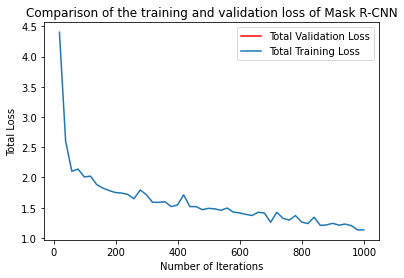

In [ ]:
### Plot training and validation loss on the same plot to check how the training has gone

import json
import matplotlib.pyplot as plt

experiment_folder = '/content/output'

def load_json_arr(json_path):
    lines = []
    with open(json_path, 'r') as f:
        for line in f:
            lines.append(json.loads(line))
    return lines

experiment_metrics = load_json_arr(experiment_folder + '/metrics.json')

plt.plot(
    [x['iteration'] for x in experiment_metrics if 'validation_loss' in x], 
    [x['validation_loss'] for x in experiment_metrics if 'validation_loss' in x], label='Total Validation Loss', color='red')
plt.plot(
    [x['iteration'] for x in experiment_metrics if 'total_loss' in x], 
    [x['total_loss'] for x in experiment_metrics if 'total_loss' in x], label='Total Training Loss')

plt.legend(loc='upper right')
plt.title('Comparison of the training and validation loss of Mask R-CNN')
plt.ylabel('Total Loss')
plt.xlabel('Number of Iterations')
plt.show()

# Testing

In [ ]:
# Setup to predict on new images, here setting up for the trees_test dataset, but can also use this setup
# for predicting on individual images as seen 2 cells down

from detectron2.utils.visualizer import ColorMode

# Weights automatically saved to OUTPUT_DIR + model_final.pth following training
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.15
cfg.DATASETS.TEST = ("trees_test",)
predictor = DefaultPredictor(cfg)

In [ ]:
#Obtain the filenames for a folder that does not have corresponding geojsons

def get_filenames(directory):
  dataset_dicts = []
  for filename in [file for file in os.listdir(directory)]:
    file = {}
    filename = os.path.join(directory, filename)
    file["file_name"] = filename

    dataset_dicts.append(file)
  return dataset_dicts

gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_test/tile_684690_4743320.png
gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_test/tile_684890_4743120.png
gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_test/tile_684490_4743320.png
gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_test/tile_684690_4743720.png
gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_test/tile_684090_4743120.png
gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_test/tile_684490_4743520.png
gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_test/tile_684490_4743120.png
gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_test/tile_684290_4743720.png
gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_test/tile_684690_4743120.png
gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_test/tile_684690_4743520.png
gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_test/tile_684490_4743720.png
gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_test/tile_684290_4743520.png
gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_test/tile_684890_4743520.png
gdrive/MyDrive/JamesHirst/NY/Buffalo/B

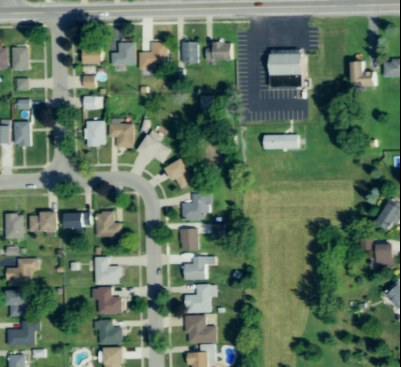

/usr/local/lib/python3.7/dist-packages/detectron2/structures/image_list.py:88: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  max_size = (max_size + (stride - 1)) // stride * stride


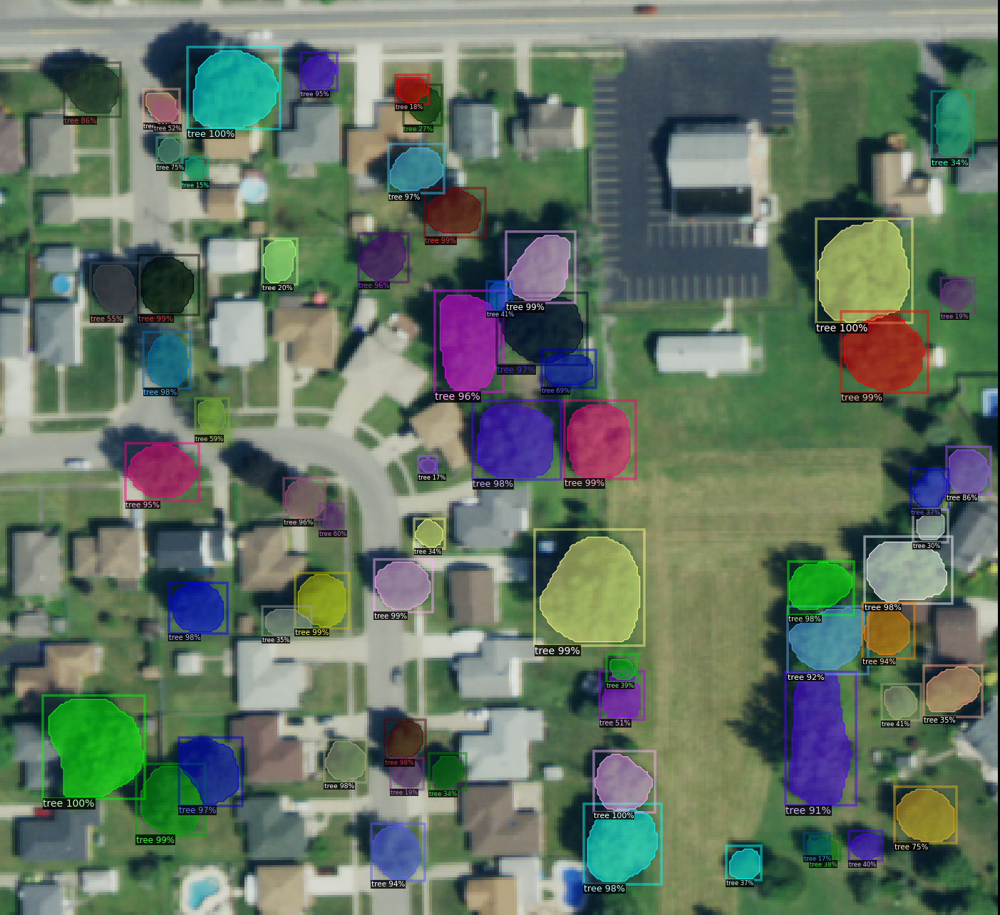

gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_predictions/prediction_684490_4743120.json
gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_predictions/prediction_684490_4743120.json
{'file_name': 'gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_test/tile_684090_4743720.png', 'height': 401, 'width': 367, 'image_id': 'gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_test/tile_684090_4743720.png', 'annotations': [{'bbox': [22.90274016209878, 6.677377589357377, 54.55902325261074, 39.33333277764416], 'bbox_mode': <BoxMode.XYXY_ABS: 0>, 'segmentation': [[40.89683791894156, 6.677377589357377, 54.55902325261074, 20.339562923026563, 50.22711082982521, 39.33333277764416, 37.231373561080545, 38.00043664779514, 23.23596419475507, 25.33792341190076, 22.90274016209878, 15.007978402078152, 40.89683791894156, 6.677377589357377]], 'category_id': 0, 'iscrowd': 0}, {'bbox': [-0.089718082454056, 1.012569036334753, 28.567548715121426, 41.6659010052681], 'bbox_mode': <BoxMode.XYXY_ABS: 0>, 'segmentation': [[0.5767299824

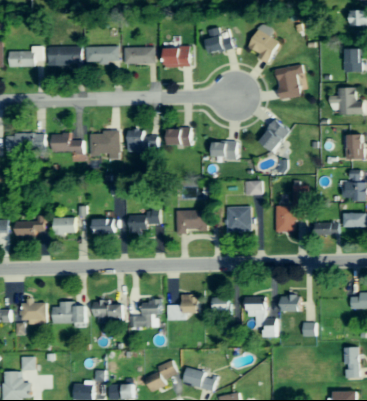

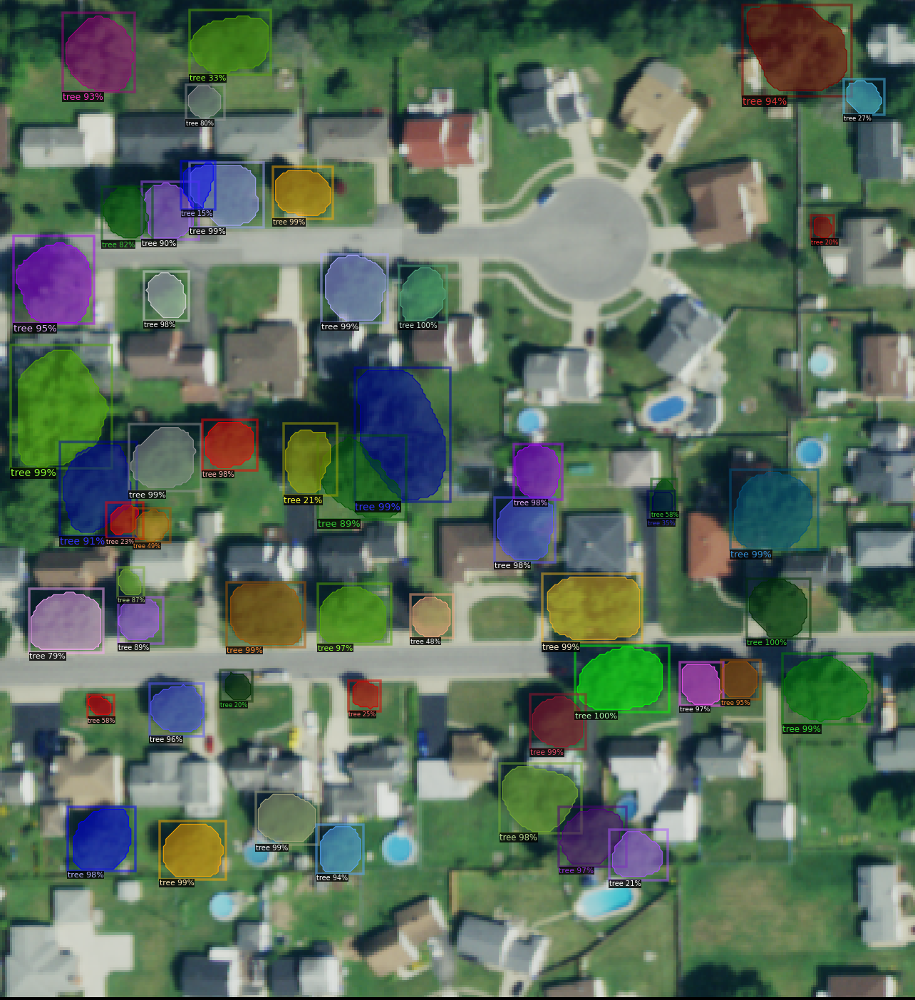

gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_predictions/prediction_684090_4743720.json
gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_predictions/prediction_684090_4743720.json
{'file_name': 'gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_test/tile_684290_4743520.png', 'height': 401, 'width': 400, 'image_id': 'gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_test/tile_684290_4743520.png', 'annotations': [{'bbox': [102.32451269131465, 32.71633503555006, 135.20123408855096, 62.795037590588095], 'bbox_mode': <BoxMode.XYXY_ABS: 0>, 'segmentation': [[117.7136163240842, 32.71633503555006, 129.95494875921094, 32.71633503555006, 131.7037105356576, 36.563610944276036, 132.4032152463527, 40.061134496393265, 132.4032152463527, 44.60791511523223, 135.20123408855096, 54.7507334196319, 131.7037105356576, 58.24825697174913, 129.25544404870988, 59.997018748583855, 122.95990165342423, 62.795037590588095, 108.96980744185082, 60.34677110364038, 104.42302682301185, 57.54875226163614, 102.32451269131465, 50.90345

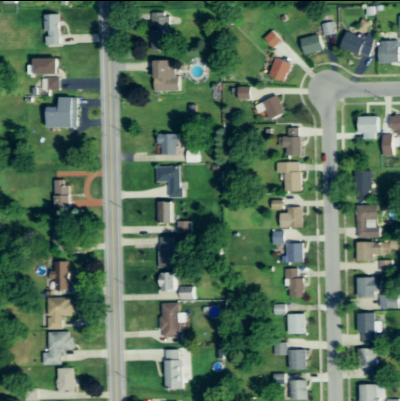

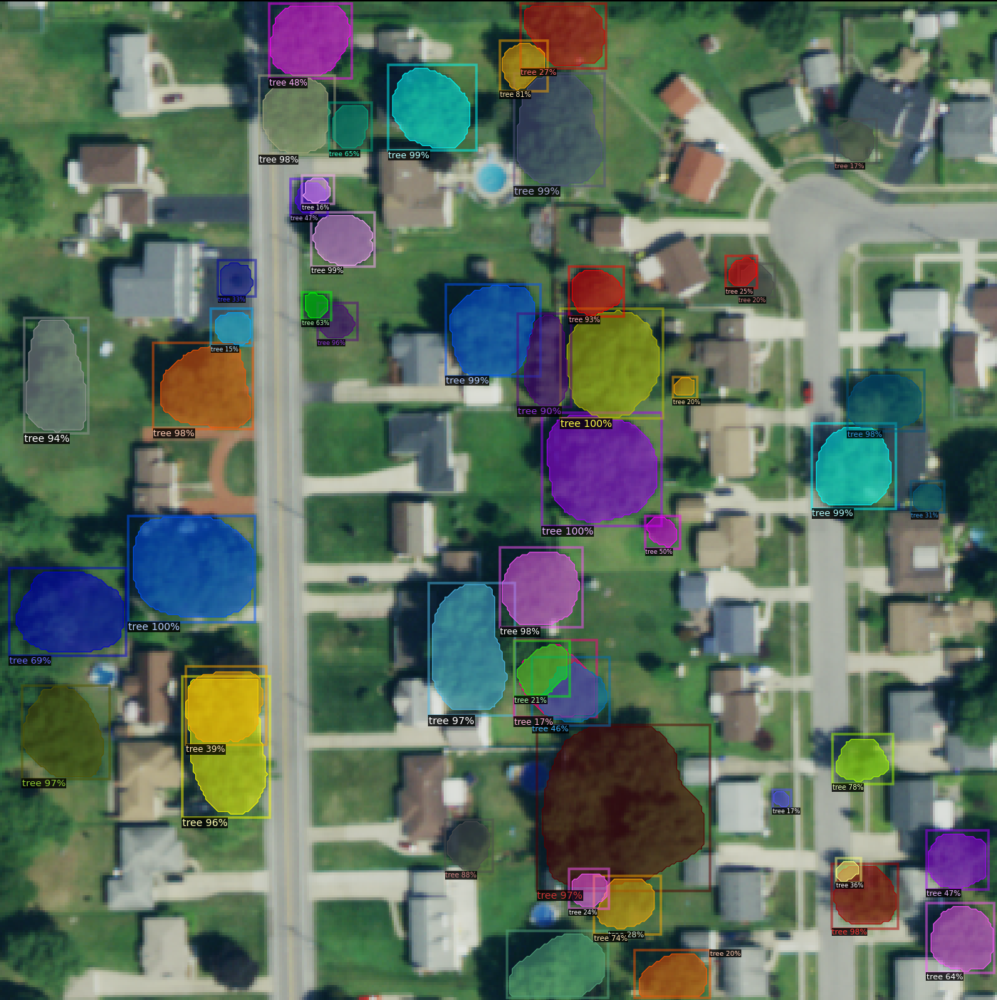

gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_predictions/prediction_684290_4743520.json
gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_predictions/prediction_684290_4743520.json
{'file_name': 'gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_test/tile_684090_4743320.png', 'height': 400, 'width': 367, 'image_id': 'gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_test/tile_684090_4743320.png', 'annotations': [{'bbox': [110.95398638669091, 7.1399118937551975, 143.57810886072306, 36.57254412615049], 'bbox_mode': <BoxMode.XYXY_ABS: 0>, 'segmentation': [[123.71994735479045, 7.849131948314607, 129.3937077850569, 7.1399118937551975, 132.23058800019015, 8.203741974818172, 137.1951283766733, 12.104452271014452, 140.74122864558984, 18.48743275428808, 143.57810886072306, 26.643463373184204, 140.74122864558984, 31.60800375044346, 136.13129829599833, 36.57254412615049, 127.9752676774903, 36.57254412615049, 119.4646270320906, 34.09027393752086, 113.79086660182415, 30.89878369588405, 111.66320644047423, 26.2888

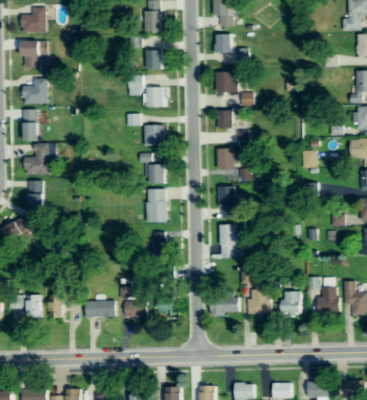

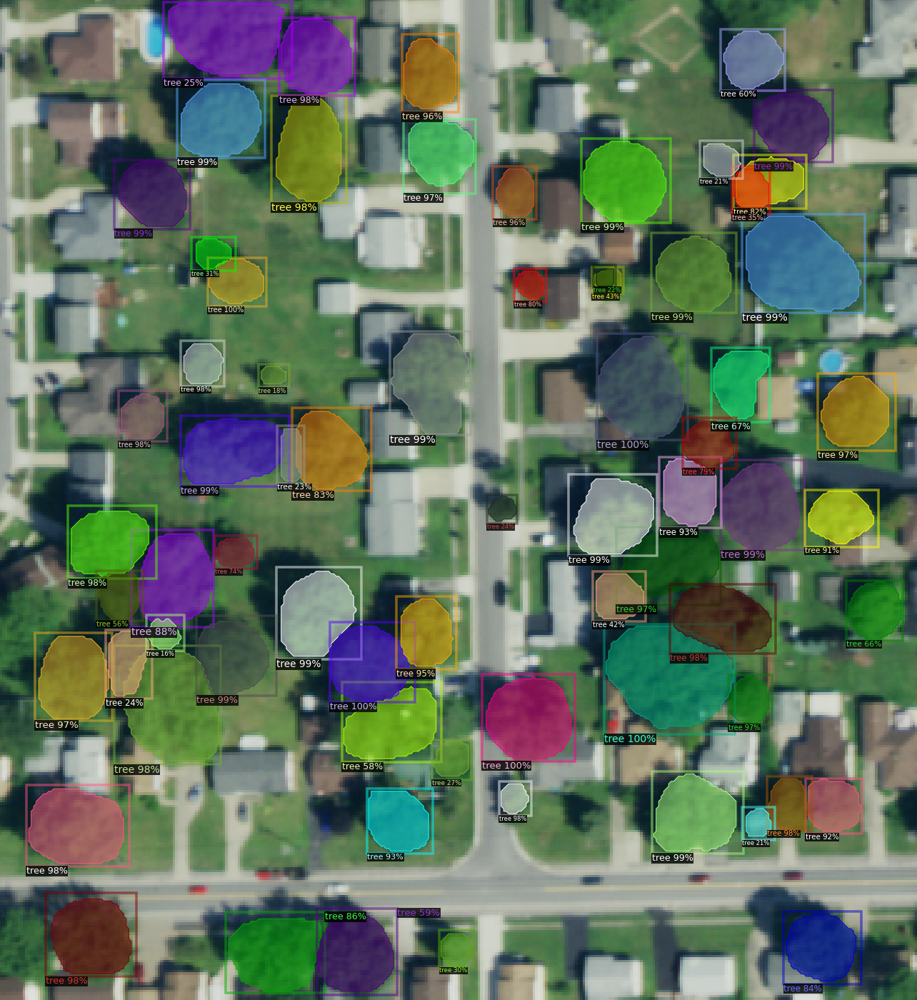

gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_predictions/prediction_684090_4743320.json
gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_predictions/prediction_684090_4743320.json
{'file_name': 'gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_test/tile_684690_4743520.png', 'height': 401, 'width': 401, 'image_id': 'gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_test/tile_684690_4743520.png', 'annotations': [{'bbox': [30.729168059964046, 53.37584866583347, 58.06476722219183, 78.56747926585376], 'bbox_mode': <BoxMode.XYXY_ABS: 0>, 'segmentation': [[50.02488511556294, 53.37584866583347, 51.09686939647266, 56.055809368689836, 54.84881437946267, 65.16767575622845, 58.06476722219183, 73.2075578616932, 48.95290083484724, 78.56747926585376, 32.87313662178349, 67.84763645753264, 30.729168059964046, 57.127793649211526, 50.02488511556294, 53.37584866583347]], 'category_id': 0, 'iscrowd': 0}, {'bbox': [77.36048427779073, 59.27176221025485, 98.2641777547542, 82.31942424923182], 'bbox_mode': <BoxMode.XYXY_ABS

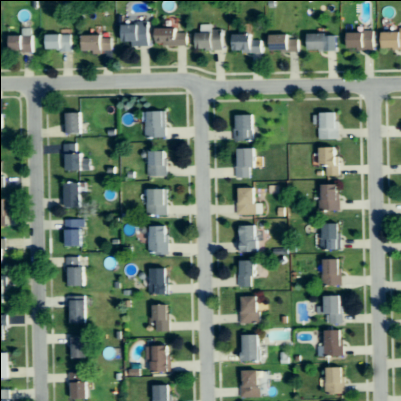

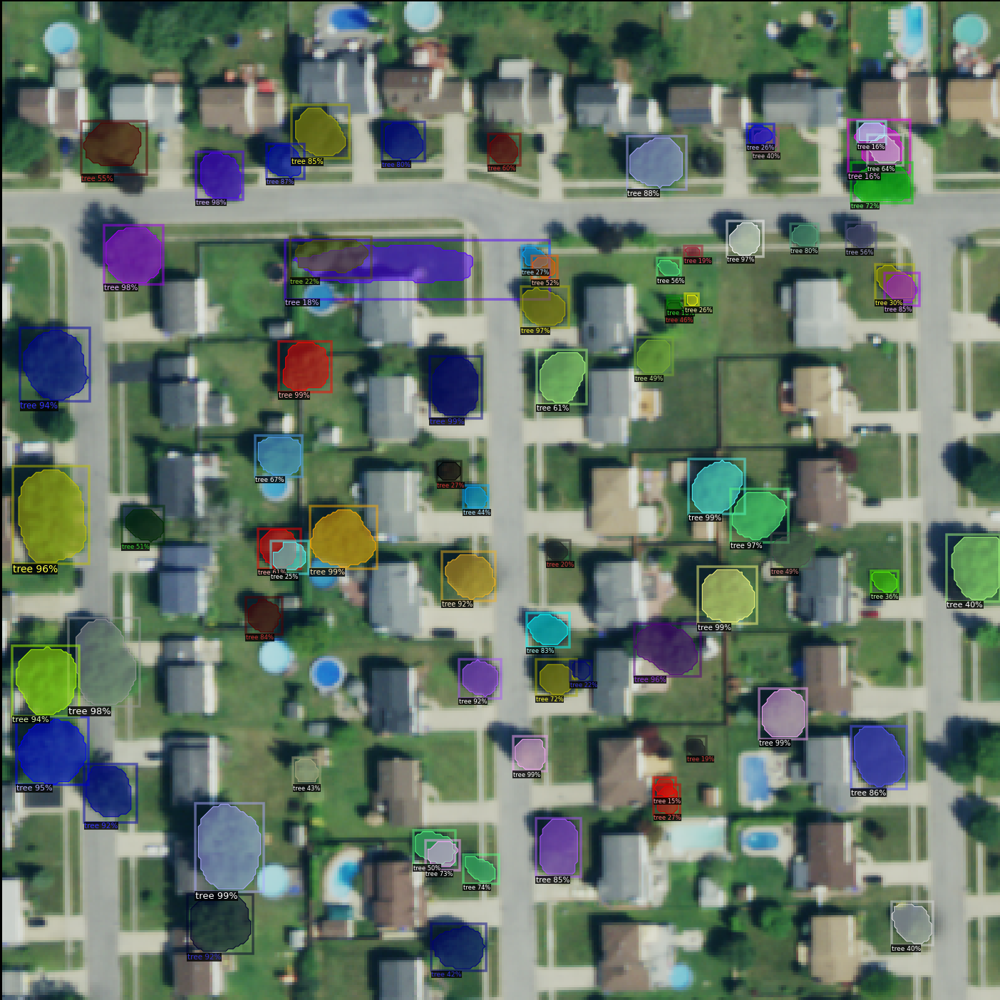

gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_predictions/prediction_684690_4743520.json
gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_predictions/prediction_684690_4743520.json
{'file_name': 'gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_test/tile_684290_4743720.png', 'height': 401, 'width': 400, 'image_id': 'gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_test/tile_684290_4743720.png', 'annotations': [{'bbox': [3.946734202327207, 8.300868988968432, 47.529660790460184, 45.126752694137394], 'bbox_mode': <BoxMode.XYXY_ABS: 0>, 'segmentation': [[10.703777084127069, 20.12569403182715, 19.48793283062211, 18.43643331186223, 20.50148926287269, 18.098581166937947, 22.86645427152204, 17.76072902356583, 25.569271424319595, 18.098581166937947, 27.93423643296895, 17.76072902356583, 29.623497153515927, 16.747172590345144, 31.650610018017083, 14.720059727008106, 31.988462162165284, 11.341538285526099, 35.029131458917014, 8.300868988968432, 39.08335718811335, 9.652277565561235, 40.7726179084663, 10.327981

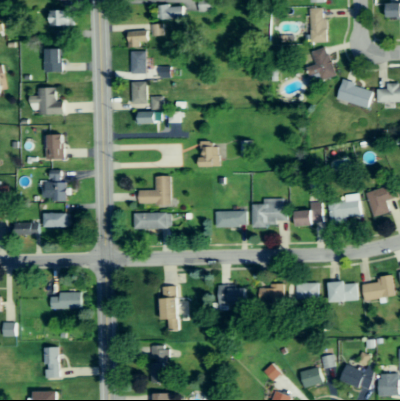

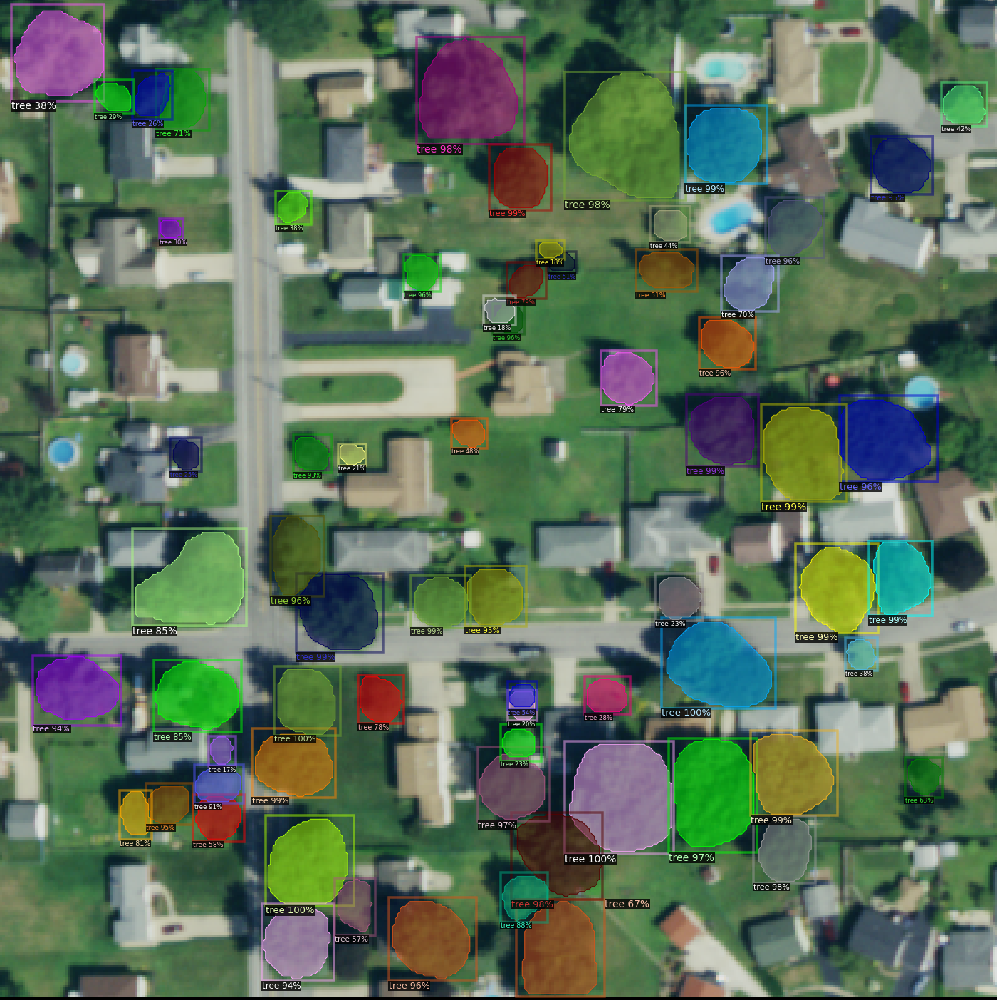

gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_predictions/prediction_684290_4743720.json
gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_predictions/prediction_684290_4743720.json
{'file_name': 'gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_test/tile_684490_4743320.png', 'height': 400, 'width': 401, 'image_id': 'gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_test/tile_684490_4743320.png', 'annotations': [{'bbox': [37.59850276614695, 32.23915131452179, 68.65366007181971, 58.28541228082031], 'bbox_mode': <BoxMode.XYXY_ABS: 0>, 'segmentation': [[54.62875032079562, 32.23915131452179, 67.65188080375083, 37.7489372870574, 68.65366007181971, 48.76850923523307, 62.14209483024509, 58.28541228082031, 49.118964347289875, 57.78452264610678, 37.59850276614695, 42.75783362798393, 44.610957641659, 35.24448911814636, 54.62875032079562, 32.23915131452179]], 'category_id': 0, 'iscrowd': 0}, {'bbox': [59.136757026426494, 2.1857732767239213, 94.19903140379272, 35.745378751307726], 'bbox_mode': <BoxMode.XYXY_ABS:

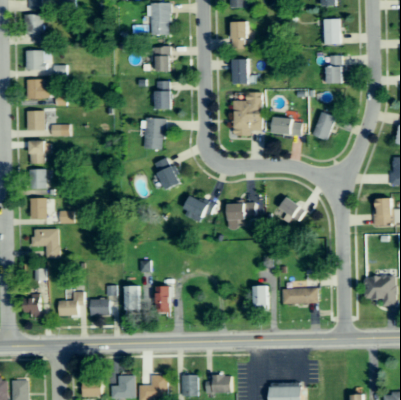

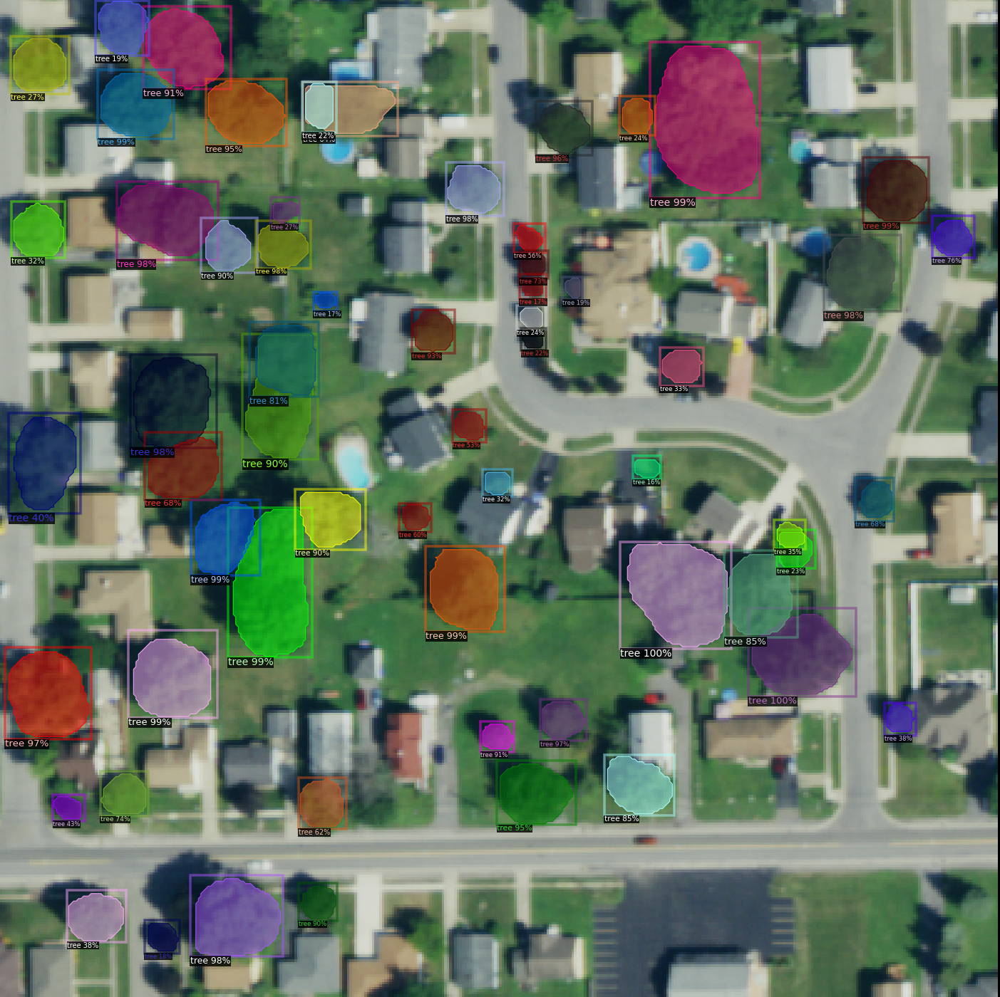

gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_predictions/prediction_684490_4743320.json
gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_predictions/prediction_684490_4743320.json
{'file_name': 'gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_test/tile_684890_4743520.png', 'height': 401, 'width': 400, 'image_id': 'gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_test/tile_684890_4743520.png', 'annotations': [{'bbox': [339.5985802195113, 15.735949278498651, 360.0395532953553, 35.76810289236403], 'bbox_mode': <BoxMode.XYXY_ABS: 0>, 'segmentation': [[343.8911845655336, 17.16681739377475, 348.5926083729525, 15.735949278498651, 350.8411154112158, 15.940359008808912, 354.5204905649492, 18.18886604687816, 355.9513586802253, 19.415324431844056, 357.79104625709203, 20.846192547120154, 358.6086851800792, 22.890289854879143, 360.0395532953553, 26.97848446884501, 358.19986571868264, 30.86226935405284, 357.79104625709203, 31.884318007156253, 354.5204905649492, 35.154873699881136, 351.2499348728064, 35.7681028

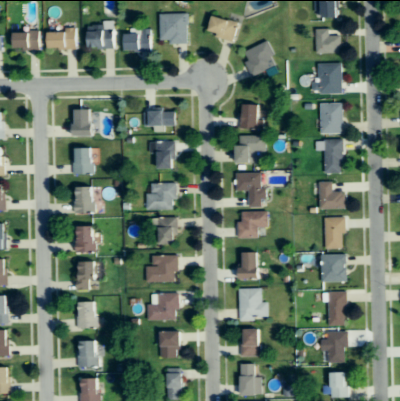

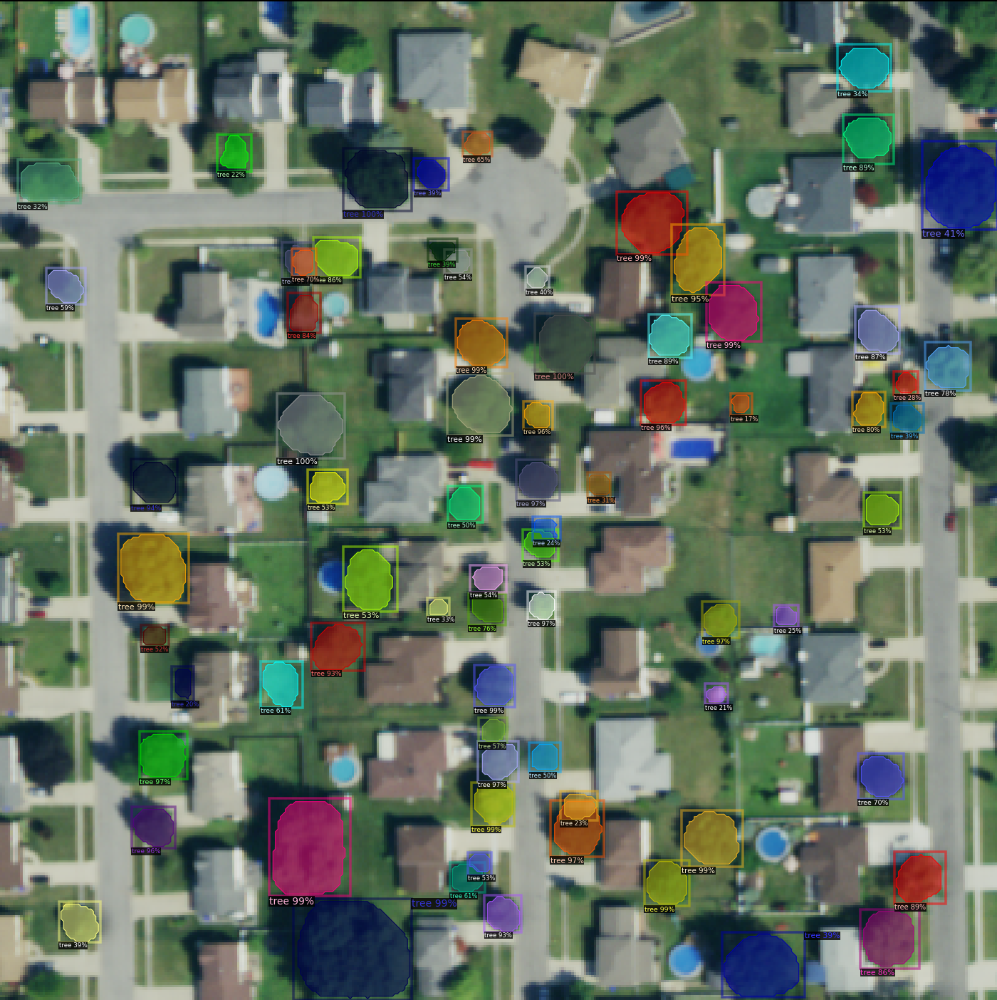

gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_predictions/prediction_684890_4743520.json
gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_predictions/prediction_684890_4743520.json
{'file_name': 'gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_test/tile_684890_4743320.png', 'height': 400, 'width': 400, 'image_id': 'gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_test/tile_684890_4743320.png', 'annotations': [{'bbox': [290.1314253759726, 39.22184964641929, 318.33996822068, 69.27008006876952], 'bbox_mode': <BoxMode.XYXY_ABS: 0>, 'segmentation': [[294.4240297219949, 41.06153722386807, 297.898995144836, 39.22184964641929, 298.30781460642663, 39.22184964641929, 303.8268773368327, 39.22184964641929, 306.4842038366866, 39.630669108591974, 310.3679887211183, 40.652717761695385, 314.0473638748517, 41.674766414798796, 315.88705145171843, 43.31004426193732, 317.9311487592835, 45.55855130000657, 318.33996822068, 50.25997510800755, 318.13555848998175, 52.91730160669732, 317.72673902839114, 55.57462810693926, 

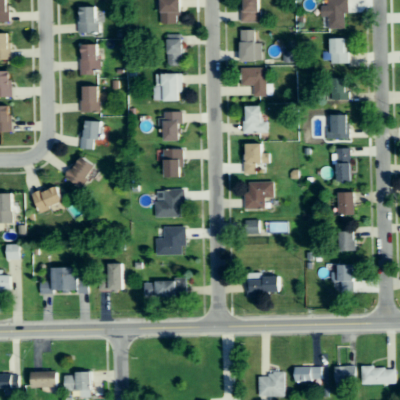

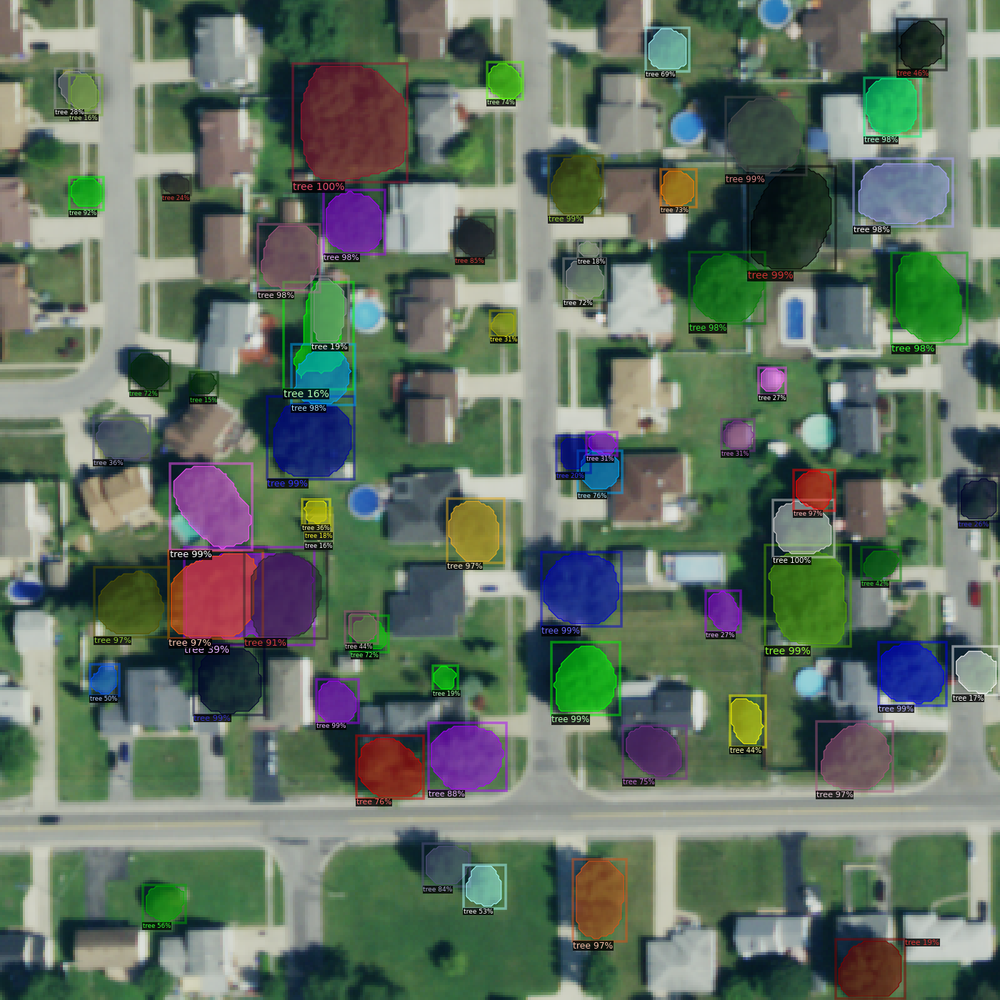

gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_predictions/prediction_684890_4743320.json
gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_predictions/prediction_684890_4743320.json
{'file_name': 'gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_test/tile_684290_4743120.png', 'height': 367, 'width': 400, 'image_id': 'gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_test/tile_684290_4743120.png', 'annotations': [{'bbox': [14.500141822500154, 29.813768866471946, 47.1242642965323, 61.37406125944108], 'bbox_mode': <BoxMode.XYXY_ABS: 0>, 'segmentation': [[25.847662683033075, 29.813768866471946, 33.649083274649456, 30.16837889297551, 37.195183543565996, 32.29603905510157, 41.45050386626584, 37.260579430808605, 47.1242642965323, 45.771220076208294, 43.57816402761576, 55.70030082917458, 38.25901362424096, 59.955621151874425, 32.585253193974495, 61.37406125944108, 22.30156241411654, 57.11874093674123, 18.046242091416694, 51.79959053453058, 14.500141822500154, 44.707389996697486, 15.563971903175116, 38.324409

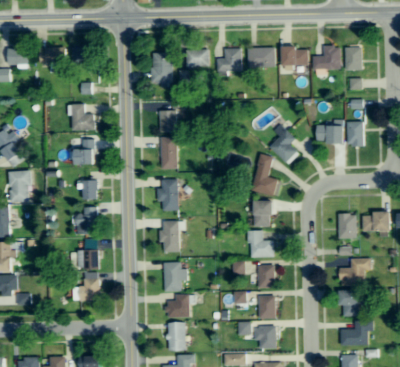

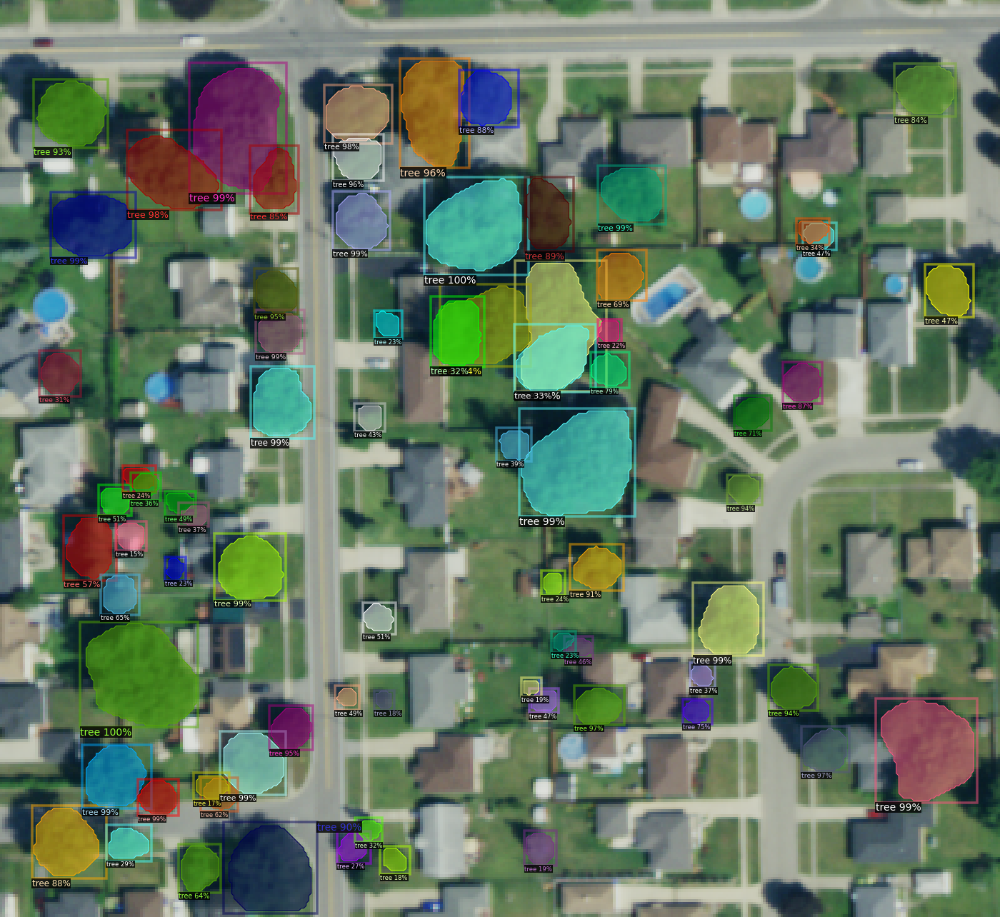

gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_predictions/prediction_684290_4743120.json
gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_predictions/prediction_684290_4743120.json
{'file_name': 'gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_test/tile_684890_4743120.png', 'height': 367, 'width': 400, 'image_id': 'gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_test/tile_684890_4743120.png', 'annotations': [{'bbox': [229.10810512160728, 24.482459000311792, 250.63809415771783, 46.01244803642231], 'bbox_mode': <BoxMode.XYXY_ABS: 0>, 'segmentation': [[233.20905541419052, 26.943029175822915, 235.25953056038514, 25.71274408729124, 235.25953056038514, 25.71274408729124, 237.1049581922125, 24.89255402982235, 240.3857184261627, 24.482459000311792, 243.25638363099037, 24.68750651429093, 244.89676374806248, 24.89255402982235, 246.94723889445112, 26.1228391168018, 249.202761555401, 28.583409292312922, 250.43304664315656, 30.838931953844906, 250.63809415771783, 32.68435958586633, 249.6128565845235, 35.96511

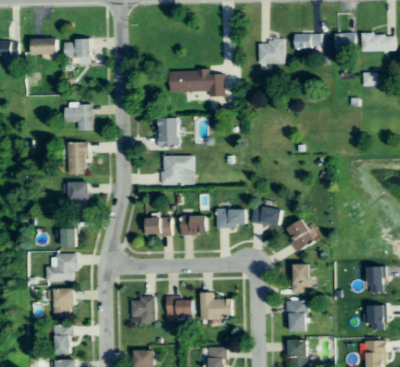

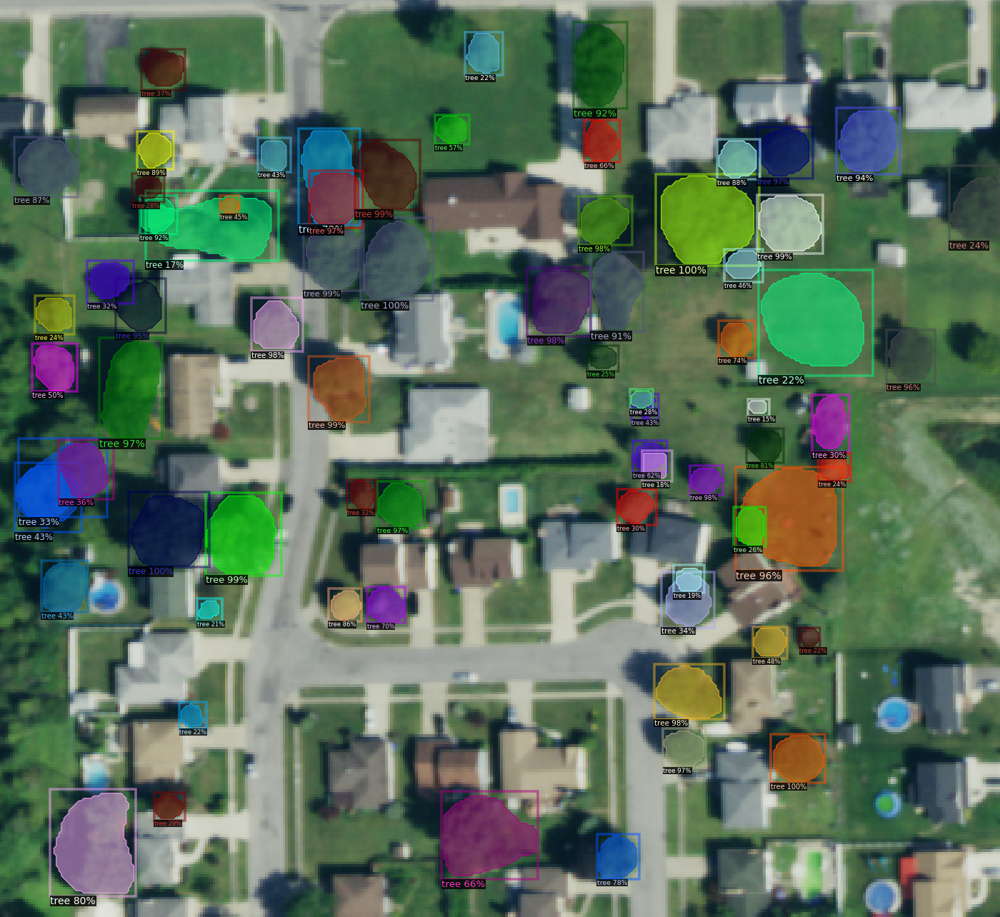

gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_predictions/prediction_684890_4743120.json
gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_predictions/prediction_684890_4743120.json
{'file_name': 'gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_test/tile_684690_4743320.png', 'height': 400, 'width': 401, 'image_id': 'gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_test/tile_684690_4743320.png', 'annotations': [{'bbox': [216.48059212117613, 359.7705235083898, 225.79679675846518, 371.23662152327597], 'bbox_mode': <BoxMode.XYXY_ABS: 0>, 'segmentation': [[219.10823958305022, 359.7705235083898, 222.21364112881324, 360.00940054965514, 222.45251817066068, 360.24827759247273, 223.64690338067402, 360.96490871782106, 224.84128859049332, 361.68153984472156, 225.79679675846518, 363.5925561795011, 225.79679675846518, 364.78694139048457, 225.79679675846518, 366.2202036411812, 225.31904267457625, 367.65346589343, 224.60241154864588, 369.3256051869442, 223.16914929659106, 370.758867439193, 221.25813296084138, 371.

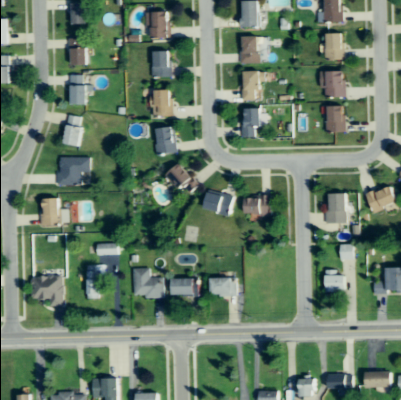

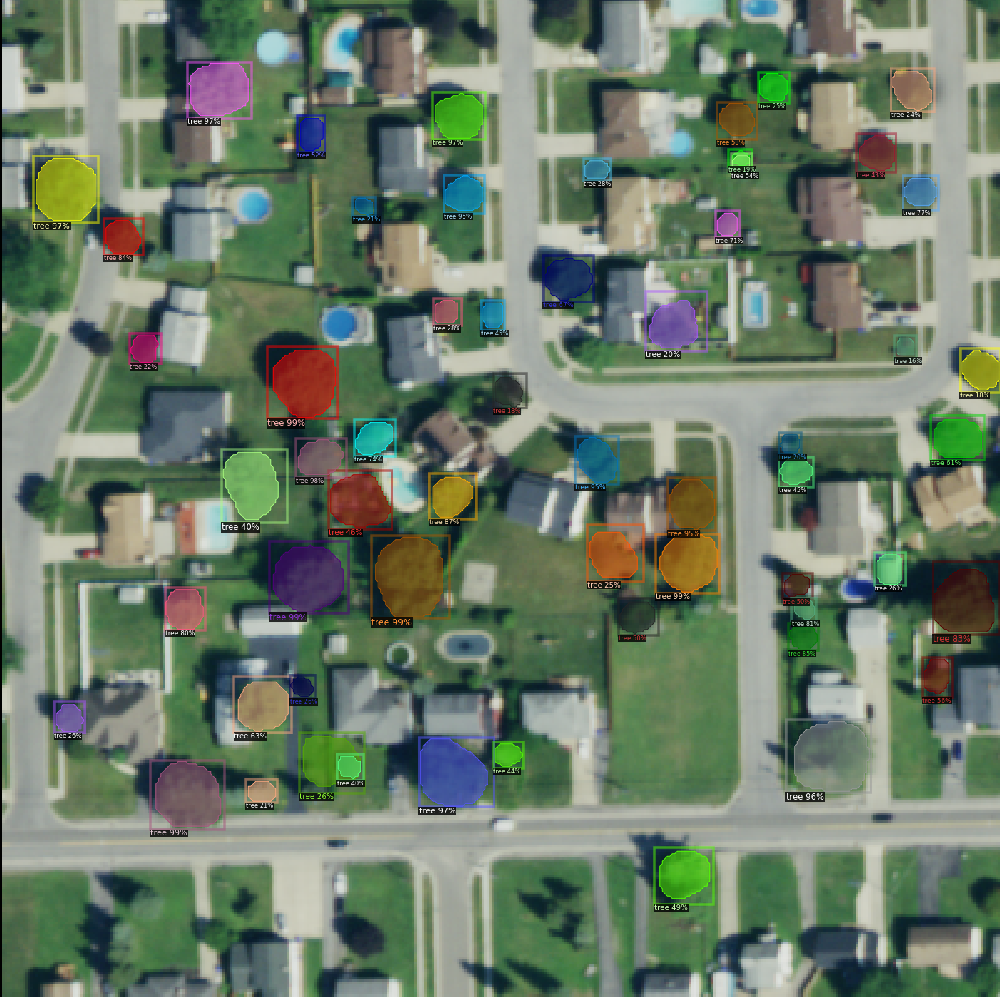

gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_predictions/prediction_684690_4743320.json
gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_predictions/prediction_684690_4743320.json
{'file_name': 'gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_test/tile_684290_4743320.png', 'height': 400, 'width': 400, 'image_id': 'gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_test/tile_684290_4743320.png', 'annotations': [{'bbox': [-2.521139468299225, 86.21794789098203, 52.44341469990711, 123.4520007142176], 'bbox_mode': <BoxMode.XYXY_ABS: 0>, 'segmentation': [[25.493052656141423, 86.21794789098203, 35.06752338221607, 96.14702864394832, 36.131353462891035, 97.21085872501135, 40.38667378559088, 98.98390885908157, 51.37958461923215, 113.52291996125132, 52.44341469990711, 120.9697305271402, 39.677453731807574, 123.09739068771398, 26.911492763708036, 123.4520007142176, 7.40794128466708, 122.03356060665101, -2.521139468299225, 111.39525980067748, -2.521139468299225, 102.17539910071838, 6.698721230883772, 92.2463183

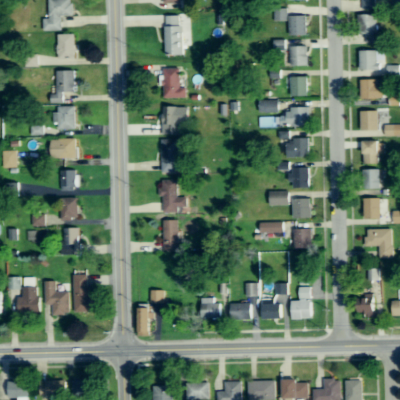

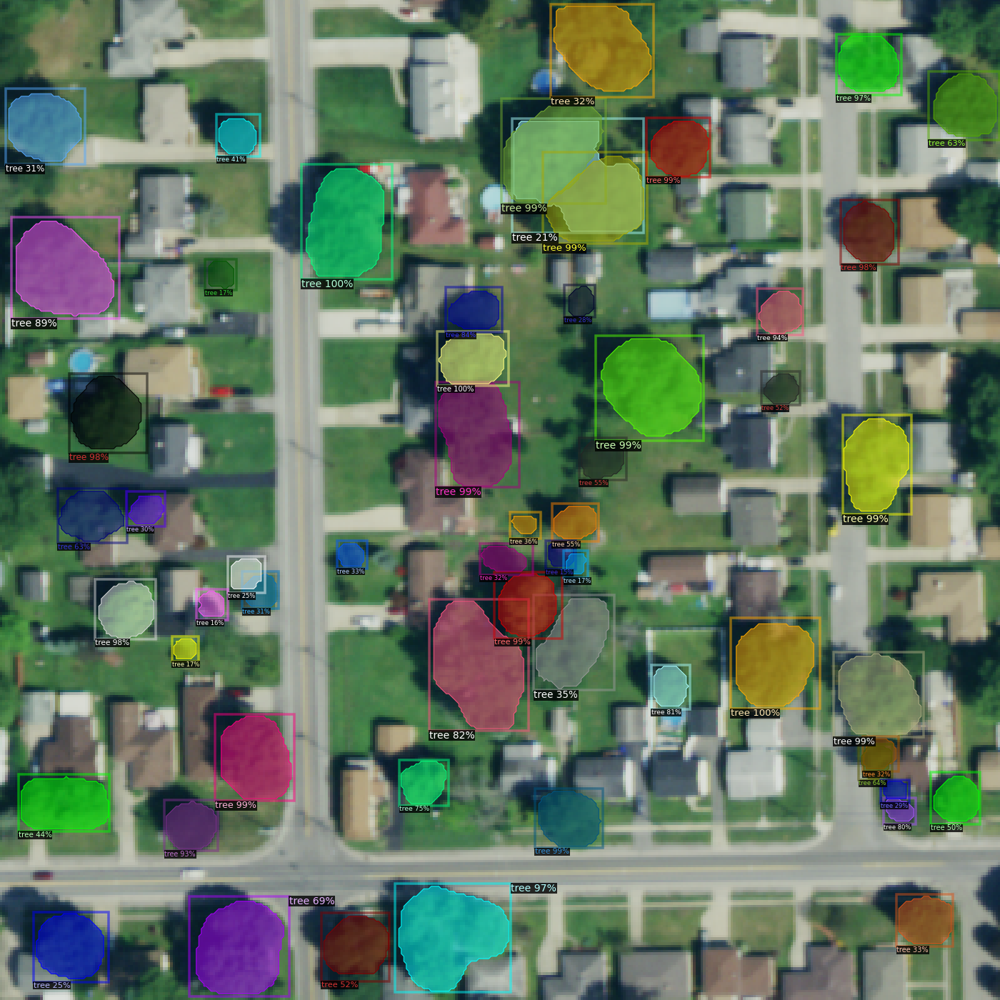

gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_predictions/prediction_684290_4743320.json
gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_predictions/prediction_684290_4743320.json
{'file_name': 'gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_test/tile_684490_4743720.png', 'height': 401, 'width': 401, 'image_id': 'gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_test/tile_684490_4743720.png', 'annotations': [{'bbox': [15.595122871454805, 51.1316011448701, 43.740139452856965, 76.59613995719701], 'bbox_mode': <BoxMode.XYXY_ABS: 0>, 'segmentation': [[24.976795065255526, 51.1316011448701, 31.677989489398897, 56.49255668340868, 33.018228374227576, 57.83279556843138, 42.84664686303586, 64.08724369853735, 43.740139452856965, 71.23518441710621, 39.71942279837094, 74.36240848215914, 34.80521355406381, 75.70264736718184, 22.29631729559818, 76.59613995719701, 15.595122871454805, 71.68193071211374, 16.041869166462373, 63.19375110852218, 16.041869166462373, 56.04581038840115, 24.976795065255526, 51.1316011448

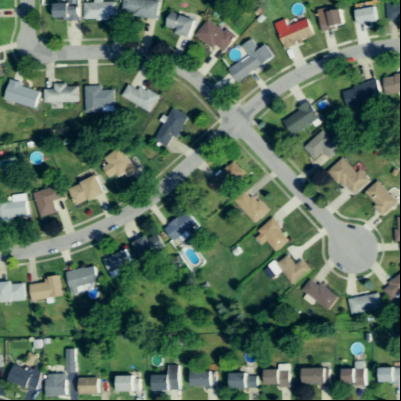

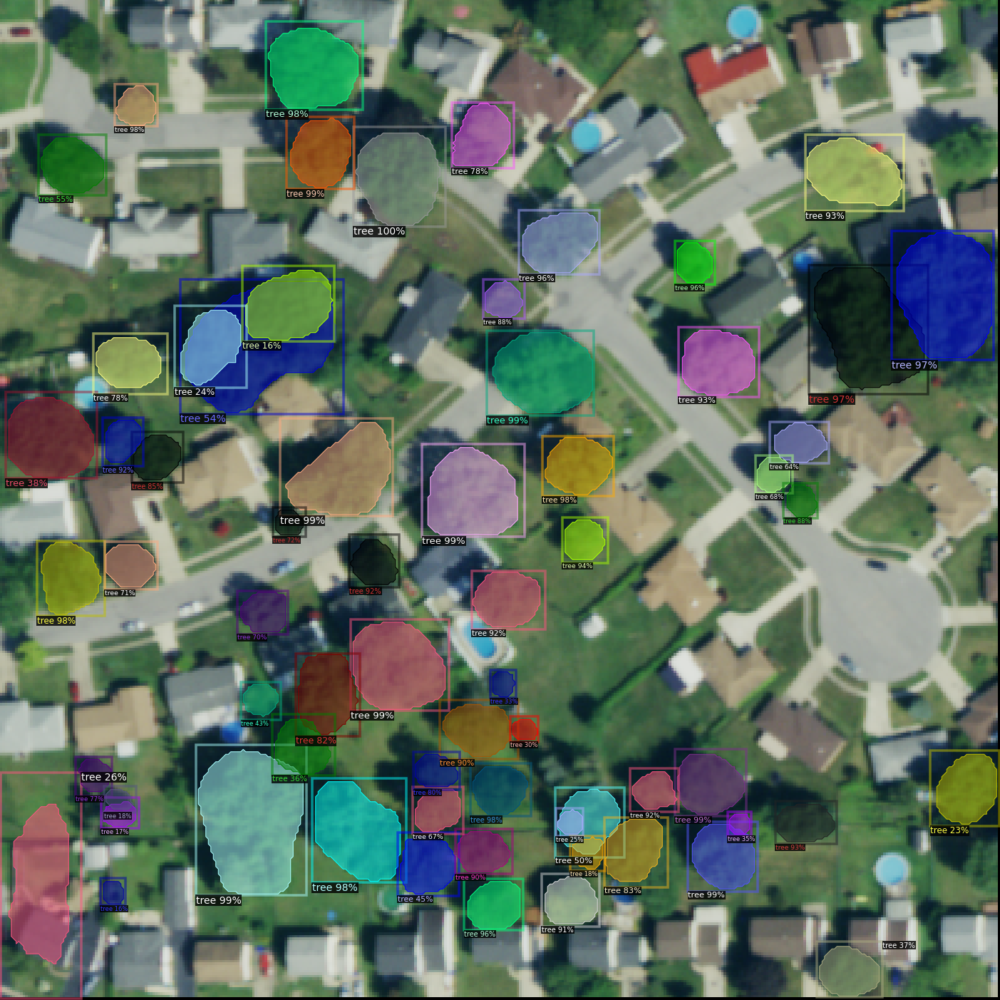

gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_predictions/prediction_684490_4743720.json
gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_predictions/prediction_684490_4743720.json
{'file_name': 'gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_test/tile_684690_4743720.png', 'height': 401, 'width': 401, 'image_id': 'gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_test/tile_684690_4743720.png', 'annotations': [{'bbox': [41.44901086867321, 45.81818068306893, 72.00056287343614, 76.90572482906282], 'bbox_mode': <BoxMode.XYXY_ABS: 0>, 'segmentation': [[63.96068076680725, 48.498141385925294, 71.46457073298129, 57.610007773463906, 72.00056287343614, 66.18588201918948, 63.96068076680725, 74.76175626646727, 51.09686939647266, 76.90572482906282, 41.44901086867321, 66.72187416100252, 41.44901086867321, 54.39405493034667, 48.95290083484724, 45.81818068306893, 63.96068076680725, 48.498141385925294]], 'category_id': 0, 'iscrowd': 0}, {'bbox': [-15.36615601721375, 106.9212846929828, 35.55309732386377, 156.232561

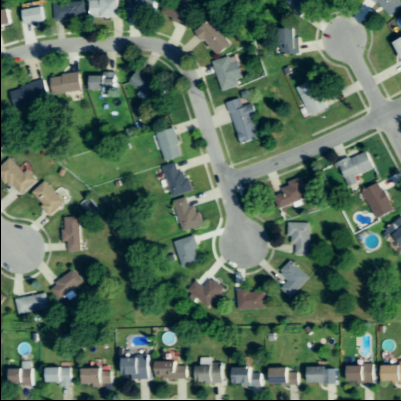

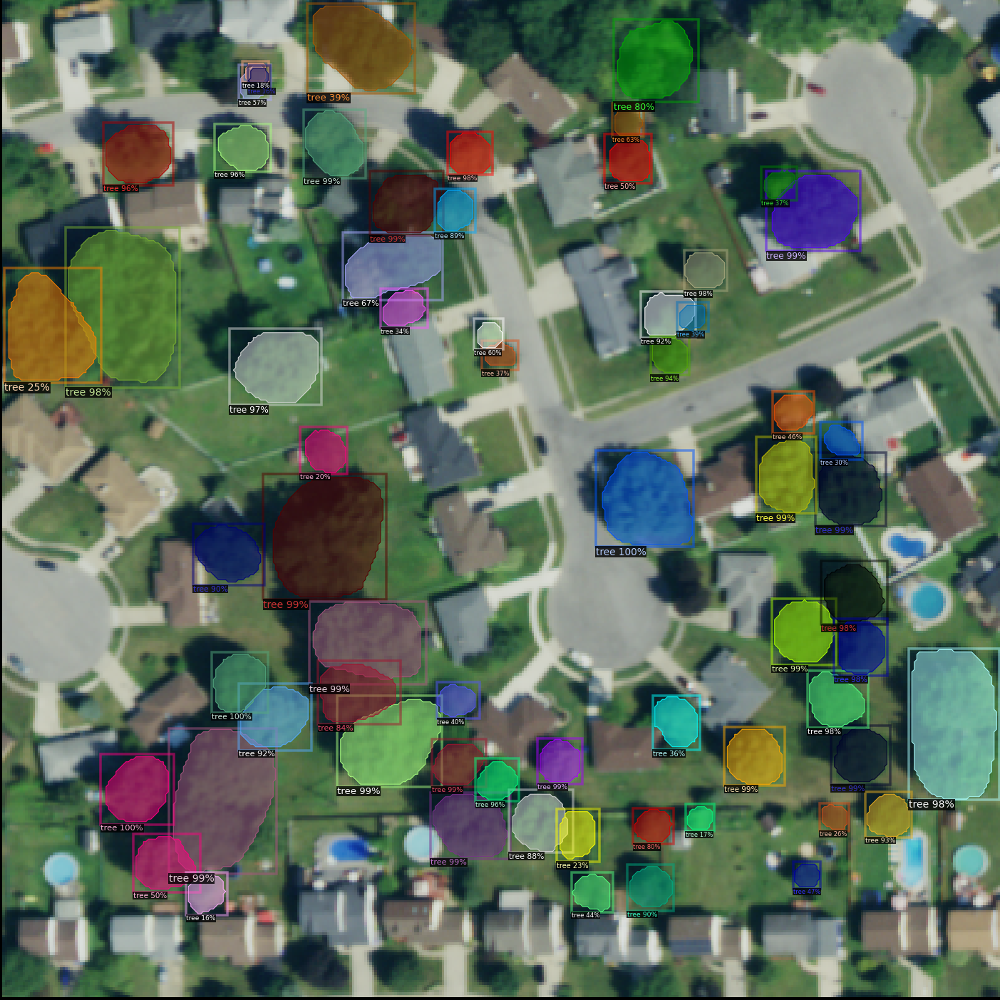

gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_predictions/prediction_684690_4743720.json
gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_predictions/prediction_684690_4743720.json
{'file_name': 'gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_test/tile_684090_4743520.png', 'height': 401, 'width': 367, 'image_id': 'gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_test/tile_684090_4743520.png', 'annotations': [{'bbox': [278.51217891826917, 59.64726639352739, 322.93072804032516, 96.02151134268689], 'bbox_mode': <BoxMode.XYXY_ABS: 0>, 'segmentation': [[302.6450914334661, 59.64726639352739, 304.3938532099128, 59.64726639352739, 307.5416244073616, 62.095532880475105, 314.88642386859283, 65.94280878764886, 319.7829568426823, 70.83934176309651, 322.93072804032516, 80.98216006594396, 316.9849380002901, 88.67671188184369, 310.6893956050044, 94.27274956740439, 304.3938532099128, 96.02151134268689, 297.3988061039321, 95.3220066325739, 295.6500443274854, 90.77522601373494, 291.453016064091, 87.27770246161765,

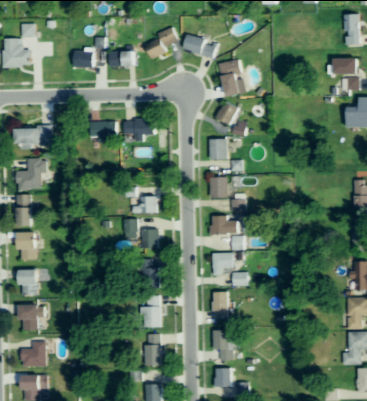

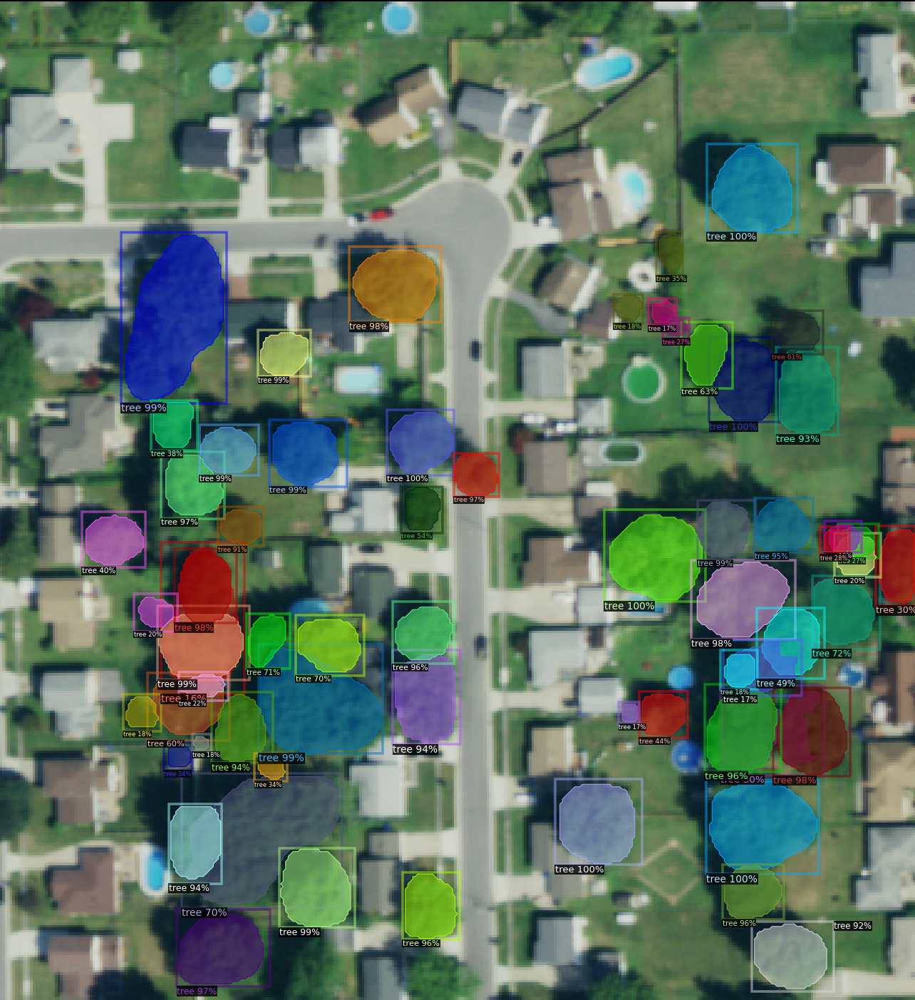

gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_predictions/prediction_684090_4743520.json
gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_predictions/prediction_684090_4743520.json
{'file_name': 'gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_test/tile_684690_4743120.png', 'height': 367, 'width': 401, 'image_id': 'gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_test/tile_684690_4743120.png', 'annotations': [{'bbox': [347.1429853422645, 118.04425058544922, 361.8834104127018, 133.4756330816696], 'bbox_mode': <BoxMode.XYXY_ABS: 0>, 'segmentation': [[349.2158576178675, 120.57776114406684, 351.51904903507483, 118.5048888682698, 352.44032560188015, 118.27456972685951, 353.82224045228213, 118.04425058544922, 355.89511272788513, 118.04425058544922, 357.73766586168983, 118.27456972685951, 358.88926157029346, 118.27456972685951, 360.04085727889714, 119.1958462940529, 361.1924529875008, 120.34744200265655, 361.8834104127018, 121.4990377112602, 361.8834104127018, 123.57190998705724, 361.6530912709035, 124.7

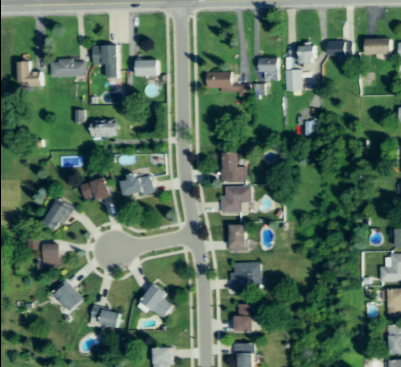

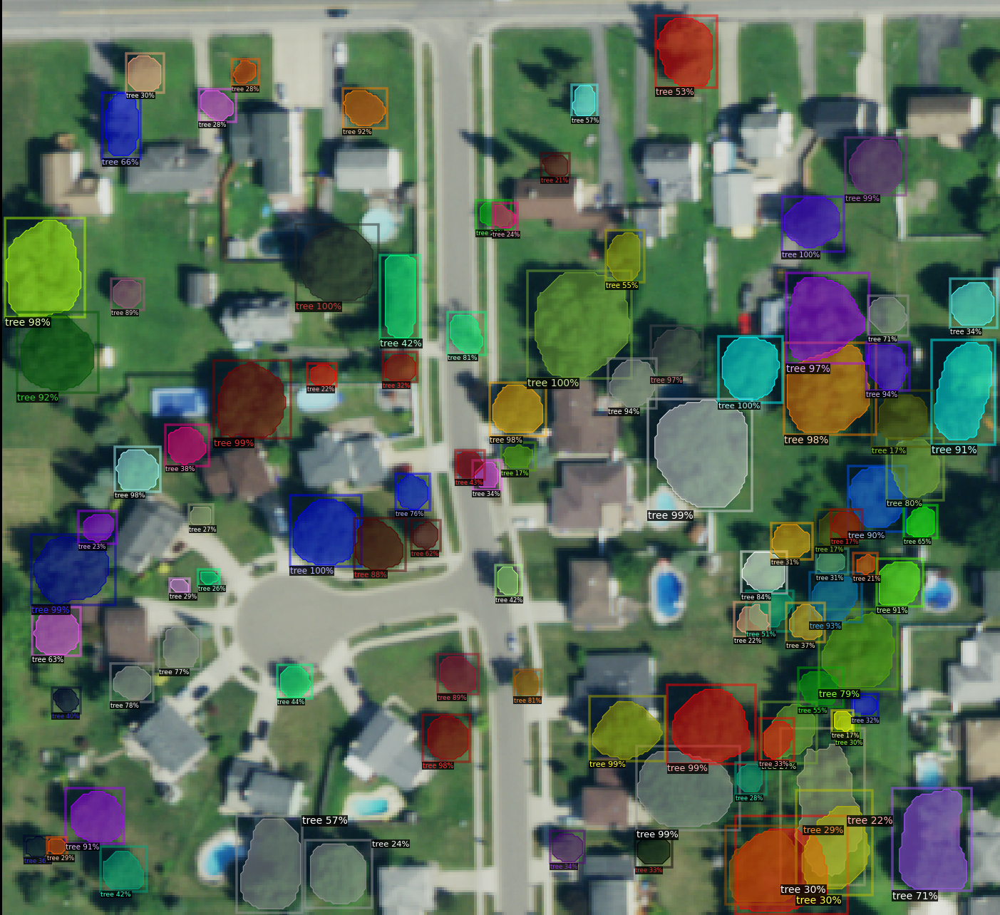

gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_predictions/prediction_684690_4743120.json
gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_predictions/prediction_684690_4743120.json
{'file_name': 'gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_test/tile_684490_4743520.png', 'height': 401, 'width': 401, 'image_id': 'gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_test/tile_684490_4743520.png', 'annotations': [{'bbox': [217.20065491448622, 17.464375257492065, 239.7123248128143, 37.83207659361261], 'bbox_mode': <BoxMode.XYXY_ABS: 0>, 'segmentation': [[232.20843484664027, 17.464375257492065, 239.7123248128143, 33.54413946997374, 238.10434839144972, 35.15211589075625, 230.0644662848208, 37.83207659361261, 221.48859203793108, 34.616123750495376, 217.20065491448622, 27.112233785291494, 232.20843484664027, 17.464375257492065]], 'category_id': 0, 'iscrowd': 0}, {'bbox': [183.43315006718817, 21.216320239317895, 209.16077280805138, 42.12001371725148], 'bbox_mode': <BoxMode.XYXY_ABS: 0>, 'segmentation': [[20

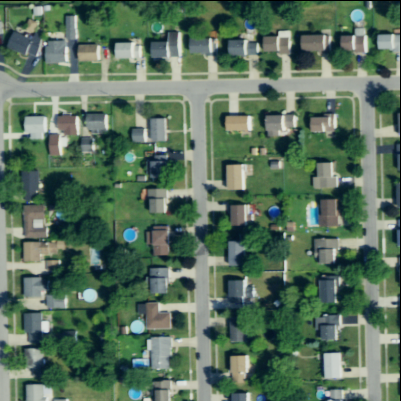

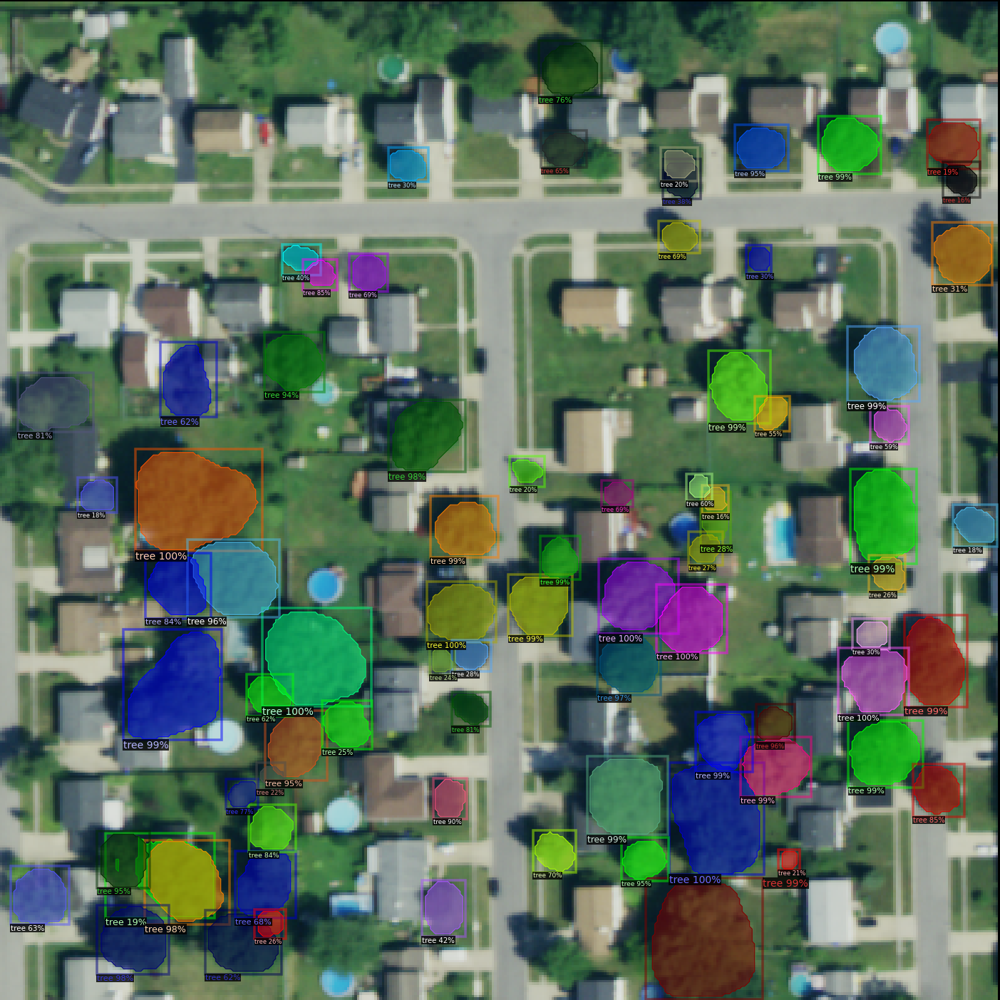

gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_predictions/prediction_684490_4743520.json
gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_predictions/prediction_684490_4743520.json
{'file_name': 'gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_test/tile_684090_4743120.png', 'height': 367, 'width': 367, 'image_id': 'gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_test/tile_684090_4743120.png', 'annotations': [{'bbox': [22.65608969066913, 26.622278624835076, 57.05326229915954, 61.019451232937456], 'bbox_mode': <BoxMode.XYXY_ABS: 0>, 'segmentation': [[35.42205065876867, 27.33149867784232, 41.45042111592678, 26.622278624835076, 54.216382084026314, 34.06908918917179, 57.05326229915954, 41.51589975350845, 52.08872192267639, 53.92725069510436, 43.5780812772767, 61.019451232937456, 36.84049076633528, 60.664841206433834, 25.138359878910705, 54.991080776167394, 22.65608969066913, 46.480440130767704, 22.65608969066913, 38.6790195383752, 26.202189959585667, 31.232208974038542, 35.42205065876867, 27.331498677

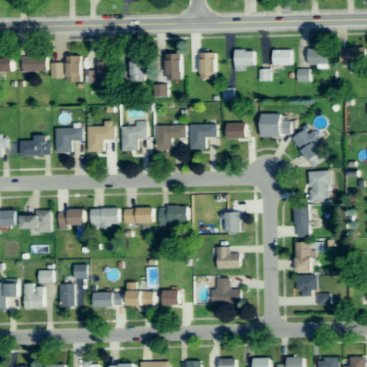

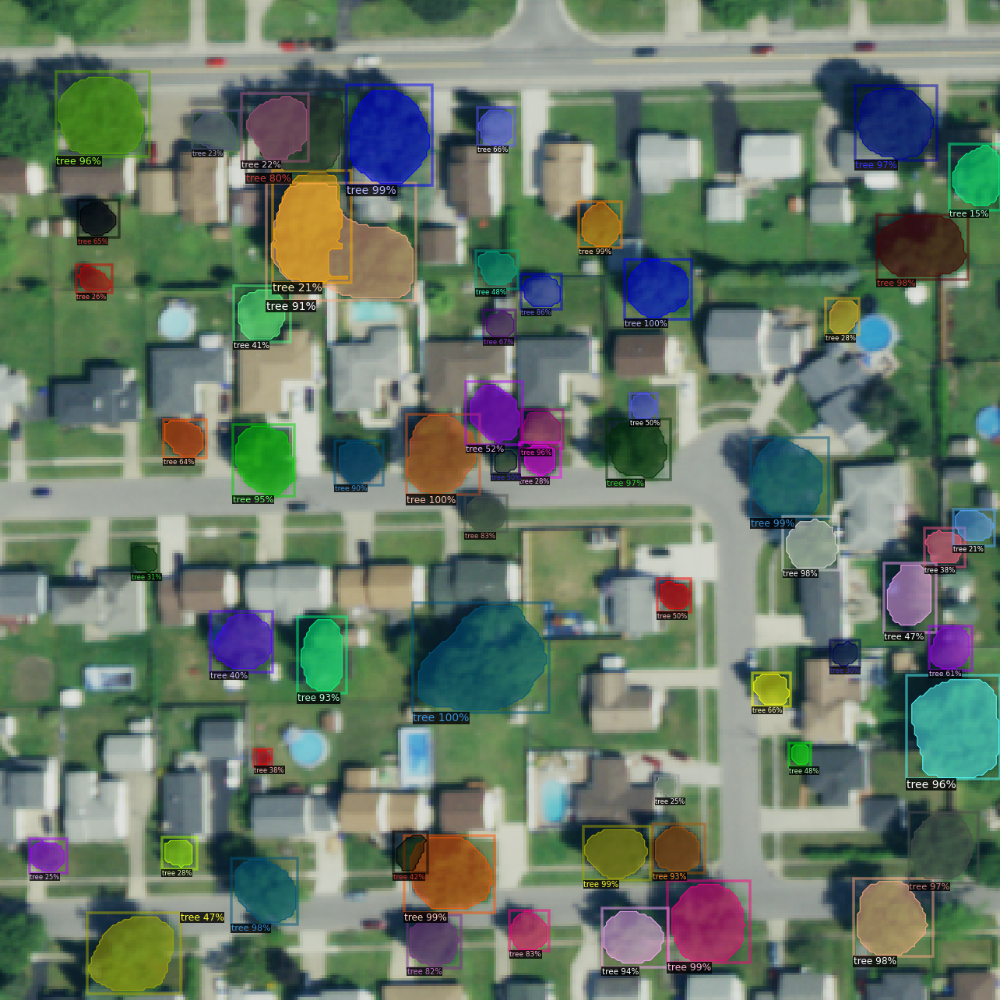

gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_predictions/prediction_684090_4743120.json
gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_predictions/prediction_684090_4743120.json
{'file_name': 'gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_test/tile_684890_4743720.png', 'height': 401, 'width': 400, 'image_id': 'gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_test/tile_684890_4743720.png', 'annotations': [{'bbox': [308.87213164164376, 47.01594887984294, 332.68290281528607, 71.06482776409632], 'bbox_mode': <BoxMode.XYXY_ABS: 0>, 'segmentation': [[332.68290281528607, 51.77810311379528, 327.20642544542596, 64.87402725871652, 324.11102519273607, 68.2075352243458, 320.5394095166897, 70.588612341322, 316.72968612886814, 71.06482776409632, 312.2056396059149, 69.63618149422109, 310.53888562387635, 64.39781183594215, 310.0626702003259, 60.34998073615134, 308.87213164164376, 55.82593421358615, 309.82456248855067, 52.730533960896196, 316.01536299373646, 49.6351337082063, 320.06319409333327, 49.3970259968

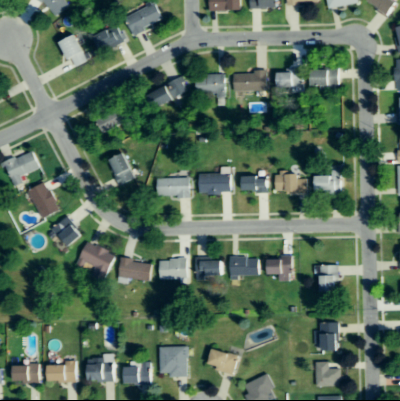

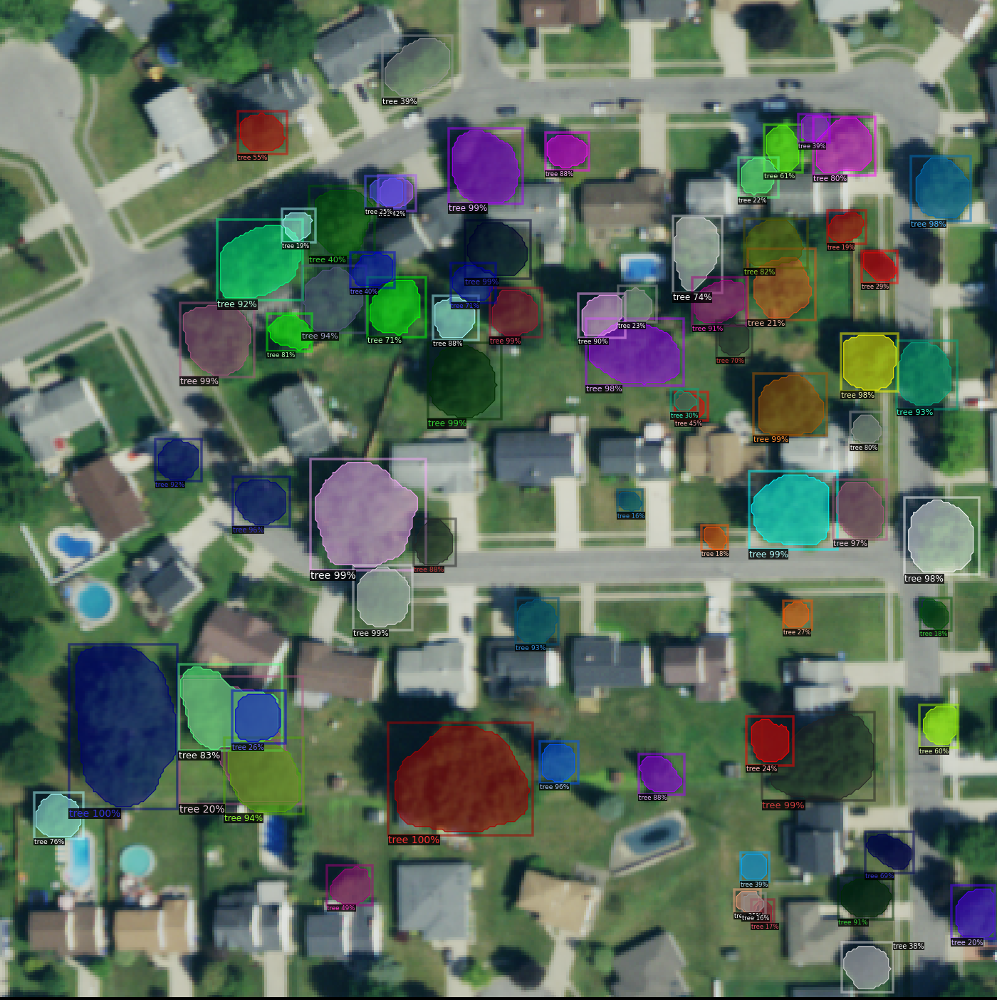

gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_predictions/prediction_684890_4743720.json
gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_predictions/prediction_684890_4743720.json


In [ ]:
# Let's look at our prediction on a test dataset!!!
from detectron2.data.datasets.coco import convert_to_coco_json
from detectron2.evaluation.coco_evaluation import instances_to_coco_json

#folder that contains the tiles that will be predicted on
directory= "gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_test/"


#list of commonly used directories
# 'gdrive/MyDrive/JamesHirst/NY/LargeArea_images/naip_cayuga/naip_cayuga_tiled_by_me/'
# 'gdrive/MyDrive/sepilok_west_test'
# "gdrive/MyDrive/JamesHirst/BCI/BCI_distributedPlots_2019/BCI_Island_2019_with_crowns_test"
# "gdrive/MyDrive/JamesHirst/BCI/BCI_50ha_2014/BCI_tiled_by_me_test/"

#if no geojsons in folder swap to get_filenames to obtain the dataset to test on 
#dataset_dicts = get_filenames(directory)
dataset_dicts = get_tree_dicts(directory)
print(dataset_dicts)

for d in random.sample(dataset_dicts, 20):
    print(d)
    img = cv2.imread(d["file_name"])
    cv2_imshow(img)
    outputs = predictor(img)
    v = Visualizer(img[:, :, ::-1], metadata=trees_metadata, scale=3.5, instance_mode=ColorMode.SEGMENTATION)   # remove the colors of unsegmented pixels
    v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    image = cv2.cvtColor(v.get_image()[:, :, ::-1], cv2.COLOR_BGR2RGB)
    display(Image.fromarray(image))

    ### Creating the file name of the output file - must be a better way to do this as it asssumes the file is called 'tile_minx_miny.png'
    file_name_path = d["file_name"]
    file_name = os.path.basename(os.path.normpath(file_name_path))  #Strips off all slashes so just final file name left
    name_split = file_name.replace(".png","").split("_")
    

    output_file = 'gdrive/MyDrive/JamesHirst/NY/Buffalo/Buffalo_predictions/prediction_'+name_split[1]+'_'+name_split[2]+'.json'
    print(output_file)

    ### Converting the predictions to json files and saving them in the specfied output file.
    # evaluations= instances_to_coco_json(outputs["instances"].to("cpu"),d["file_name"])
    # print(output_file)
    # with open(output_file, "w") as dest:
    #   json.dump(evaluations,dest)


!zip -r /content/file.zip /content/Folder_To_Zip  from google.colab import files
files.download("/content/file.zip")

In [ ]:
#!zip -r /content/output.zip /content/output
#from google.colab import files
#files.download("/content/output.zip")